# Query

## Load queried_pmids.csv 

In [4]:
import csv

pmids = []
with open("queried_pmids.csv", newline="", encoding="utf-8") as f:
    reader = csv.reader(f)
    for row in reader:
        pmids.append(row[0])   # first column

print(pmids)       # ['12345', '67890', ...]

['36717', '57628', '79941', '79942', '79943', '106416', '110628', '135488', '263435', '266609', '300896', '305042', '317004', '351220', '353484', '360575', '365897', '391314', '394776', '401217', '405402', '427609', '434871', '460920', '470786', '498229', '513428', '523751', '535504', '536025', '576112', '593444', '594852', '618560', '638812', '657192', '700885', '732828', '737698', '747995', '753760', '782595', '788399', '824491', '835021', '839681', '859724', '897800', '927473', '951232', '1091883', '1114286', '1121270', '1133513', '1134140', '1147666', '1189061', '1199118', '1207943', '1209606', '1212729', '1245970', '1250631', '1271392', '1328117', '1396899', '1401313', '1492038', '1495952', '1496285', '1499213', '1537362', '1624949', '1647170', '1734346', '1813514', '1918456', '1918486', '1943688', '1948246', '2020639', '2040343', '2073665', '2188121', '2248197', '2270175', '2275501', '2316305', '2355378', '2383921', '2425973', '2453728', '2499586', '2515375', '2632541', '2643557'

In [5]:
print(len(pmids))

1474


## Fetch data from each queried pmid to get related entities and relations

In [6]:
import requests
import json, pprint

originalentities = dict()
originalrelations = dict()

for pmid in pmids:
    print(f"Fetching data for PMID: {pmid}")
    url = f"https://www.ncbi.nlm.nih.gov/research/pubtator-api/publications/export/biocjson?pmids={pmid}"
    

    response = requests.get(url)
    # result = dict()
    # result['pmid'] = pmid
    
    if response.status_code == 200:
        datajson = response.json()
        # pprint.pprint(datajson, width=120, sort_dicts=False)
        print("\nEntities")
        for passage in datajson['PubTator3'][0]['passages']: # each passage is a part of the document, can be title, abstract, introduction...
            # print("Section:", passage['infons'].get('section', 'N/A')) 
            # print("Text:", passage['text']) 
            # print("\nEntities:") 
            for entity in passage.get('annotations', []): # each passage has it own annotations, each annotation is about one entity
                id = entity['infons']['normalized_id']
                if id == None:
                    continue
                id = str(id)
                if id not in originalentities:
                    originalentities[id] = dict()
                    originalentities[id]['name'] = entity['infons']['name']
                    originalentities[id]['type'] = entity['infons']['biotype']
                    originalentities[id]['pmids'] = set()
                    originalentities[id]['pmids'].add(pmid)
                    originalentities[id]['accession'] = entity['infons'].get('accession', 'unknown')
                    originalentities[id]['subtype'] = entity['infons'].get('subtype', 'unknown')
                    originalentities[id]['gene_ids'] = entity['infons'].get('gene_ids', 'unknown')
                    print(id, originalentities[id])
                else:
                    print(f"Append {pmid} to set {originalentities[id]['pmids']}")
                    originalentities[id]['pmids'].add(pmid)

                

        print("\nRelations:")
        for rel in datajson['PubTator3'][0]['relations']:
            thisrel = dict()
            thisrel['type'] = rel['infons'].get('type', 'unknown')
            thisrel['r1'] = rel['infons']['role1']['normalized_id']
            thisrel['r2'] = rel['infons']['role2']['normalized_id']
            thisrel['r1accession'] = rel['infons']['role1'].get('accession', 'unknown')
            thisrel['r2accession'] = rel['infons']['role2'].get('accession', 'unknown') 
            thisrel['score'] = rel['infons'].get('score', 'unknown')
            thisrel['pmids'] = pmid
            triplet = (thisrel['r1accession'], thisrel['type'], thisrel['r2accession'])
            if triplet not in originalrelations:
                originalrelations[triplet] = dict()
                originalrelations[triplet]['r1'] = thisrel['r1']
                originalrelations[triplet]['r2'] = thisrel['r2']
                originalrelations[triplet]['r1accession'] = thisrel['r1accession']
                originalrelations[triplet]['r2accession'] = thisrel['r2accession']
                originalrelations[triplet]['pmids'] = set()
                originalrelations[triplet]['pmids'].add(pmid)
                originalrelations[triplet]['score'] = []
                originalrelations[triplet]['score'].append(thisrel['score'])
                print(triplet, originalrelations[triplet])
            else:
                print(f"Append {pmid} to set {originalrelations[triplet]['pmids']}")
                originalrelations[triplet]['pmids'].add(pmid)
                originalrelations[triplet]['score'].append(thisrel['score'])
            
        print("\n" + "="*50)
    else:
        print("Failed to fetch data:", response.status_code)

Fetching data for PMID: 36717

Entities
C537537 {'name': 'Segawa syndrome autosomal recessive', 'type': 'disease', 'pmids': {'36717'}, 'accession': '@DISEASE_Segawa_syndrome_autosomal_recessive', 'subtype': 'unknown', 'gene_ids': 'unknown'}
D005355 {'name': 'Fibrosis', 'type': 'disease', 'pmids': {'36717'}, 'accession': '@DISEASE_Fibrosis', 'subtype': 'unknown', 'gene_ids': 'unknown'}
D014443 {'name': 'Tyrosine', 'type': 'chemical', 'pmids': {'36717'}, 'accession': '@CHEMICAL_Tyrosine', 'subtype': 'unknown', 'gene_ids': 'unknown'}
Append 36717 to set {'36717'}
C010590 {'name': '4-hydroxyphenylpyruvic acid', 'type': 'chemical', 'pmids': {'36717'}, 'accession': '@CHEMICAL_4_hydroxyphenylpyruvic_acid', 'subtype': 'unknown', 'gene_ids': 'unknown'}
D006713 {'name': 'Homogentisic Acid', 'type': 'chemical', 'pmids': {'36717'}, 'accession': '@CHEMICAL_Homogentisic_Acid', 'subtype': 'unknown', 'gene_ids': 'unknown'}
D002245 {'name': 'Carbon Dioxide', 'type': 'chemical', 'pmids': {'36717'}, 'acc

In [7]:
print(len(originalentities))
print(len(originalrelations))

1245
906


In [8]:
entitylist = []
for id, entity in originalentities.items():
    entity['id'] = str(id)
    entitylist.append(entity)

In [10]:
relationlist = []
for triple, relation in originalrelations.items():
    relation['id'] = triple
    relation['type'] = triple[1]
    relationlist.append(relation) 

In [11]:
with open("originalentities.csv", "w", newline="", encoding="utf-8") as f:
    writer = csv.DictWriter(f, fieldnames=entitylist[0].keys())
    writer.writeheader()
    writer.writerows(entitylist)

In [12]:
with open("originalrelations.csv", "w", newline="", encoding="utf-8") as f:
    writer = csv.DictWriter(f, fieldnames=relationlist[0].keys())
    writer.writeheader()
    writer.writerows(relationlist)

In [13]:
print(len(relationlist))

906


In [14]:
print(len(entitylist))

1245


## Visualize the original network 

### Define functions 

In [15]:
import ast 
import re

def prepareForVisualization(entitydict, relationlist):
    refinedrelations = dict()
    unique_relationtypes = set()
    unique_entitytypes = set()

    genesWithVariants = set()

    for rel in relationlist:
        print(rel) 
        r1 = (rel['r1'])
        r2 = (rel['r2'])
        rtype = rel['type']

        unique_relationtypes.add(rtype)
        if not r1 or not r2:
            continue

        
        r1main, r1gene, r1type = None, None, None
        try: 
            r1main = entitydict[str(r1)]['accession']
            r1type = entitydict[str(r1)]['type']
        except:
            print("Cannot find {} in list entities".format(r1))

        if not r1main or not r1type:
            continue

        if '#' in str(r1): # case of variant 
            try:
                r1geneid = str(entitydict[r1]['gene_ids'][0])
                r1gene = entitydict[r1geneid]['accession']
                r1genetype = entitydict[r1geneid]['type']
                unique_entitytypes.add(r1genetype)
                print("Found gene {} associated with variant {}".format(r1geneid, r1main))
            except:
                print("Cannot find gene {} associated with variant {} in list entities".format(r1geneid, r1main))

        r2main, r2gene, r2type = None, None, None 
        try:
            r2main = entitydict[str(r2)]['accession']
            r2type = entitydict[str(r2)]['type']
        except:
            print("Cannot find {} in list entities".format(r2))
        
        if not r2main or not r2type:
            continue
        
        if "#" in str(r2): # in case of variant  
            try: 
                r2geneid = str(entitydict[r2]['gene_ids'][0])
                r2gene = entitydict[r2geneid]['accession']
                r2genetype = entitydict[r2geneid]['type']
                unique_entitytypes.add(r2genetype)
                print("Found gene {} associated with variant {}".format(r2geneid, r2main))
            except:
                print("Cannot find gene {} associated with variant {} in list entities".format(r2geneid, r2main))

        unique_entitytypes.add(r1type)
        unique_entitytypes.add(r2type)
        
        triplet = (r1main, rtype, r2main)

        scores = rel['score']
        scores = [float(x) for x in scores if float(x) <= 1.0]
        ascore = sum(scores)/len(scores)
        # scorecount  = len(scores)

        if triplet not in refinedrelations:
            # print(triplet)
            refinedrelations[triplet] = {
                'score': ascore,
                'pmids': rel['pmids'], # originally a set 
                'r1type': r1type,
                'r2type': r2type
            }
        else:
            refinedrelations[triplet]['pmids'] = refinedrelations[triplet]['pmids'].union(rel['pmids'])
            print("Append {} to set {}".format(rel['pmids'], refinedrelations[triplet]['pmids']))
            # refinedrelations[triplet]['score'] = (refinedrelations[triplet]['score'] + ascore)/2  # average score

        
        if r1gene:
            genesWithVariants.add(r1gene)
            r1genetriplet = (r1gene, rtype, r2main)
            if r1genetriplet not in refinedrelations:
                refinedrelations[r1genetriplet] = {
                    'score': ascore,
                    'pmids': rel['pmids'], # originally a set 
                    'r1type': r1genetype,
                    'r2type': r2type
                }
            else:
                refinedrelations[r1genetriplet]['pmids'] = refinedrelations[r1genetriplet]['pmids'].union(rel['pmids'])
                print("Append {} to set {}".format(rel['pmids'], refinedrelations[r1genetriplet]['pmids']))
                # refinedrelations[r1genetriplet]['score'] = (refinedrelations[r1genetriplet]['score'] + ascore)/2  # average score

        if r2gene:
            genesWithVariants.add(r2gene)
            r2genetriple = (r1main, rtype, r2gene)
            if r2genetriple not in refinedrelations:
                refinedrelations[r2genetriple] = {
                    'score': ascore,
                    'pmids': rel['pmids'], # originally a set 
                    'r1type': r1type,
                    'r2type': r2genetype
                }
            else: 
                refinedrelations[r2genetriple]['pmids'] = refinedrelations[r2genetriple]['pmids'].union(rel['pmids'])
                print("Append {} to set {}".format(rel['pmids'], refinedrelations[r2genetriple]['pmids']))
                # refinedrelations[r2genetriple]['score'] = (refinedrelations[r2genetriple]['score'] + ascore)/2  # average score



    for pairid, pairinfo in refinedrelations.items():
        print(pairid)
        print(pairinfo['score'])
        print(pairinfo['pmids'])
        print(pairinfo['r1type'], pairinfo['r2type'])
        print("="*50)
        
    print(unique_relationtypes)
    print(unique_entitytypes)

    return refinedrelations, unique_entitytypes, unique_relationtypes, genesWithVariants

In [ ]:
from pyvis.network import Network
import statistics
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import networkx as nx

def construct_relation_graph_with_legend(relation_dict, entity_types, relation_types, threshold, genesWithVariants = None):
    G = nx.Graph()

    # Generate color maps
    cmap_entities = cm.get_cmap('tab20b', len(entity_types))
    cmap_relations = cm.get_cmap('Dark2', len(relation_types))

    entity_color_map = {etype: mcolors.to_hex(cmap_entities(i)) for i, etype in enumerate(sorted(entity_types))}
    relation_color_map = {rtype: mcolors.to_hex(cmap_relations(i)) for i, rtype in enumerate(sorted(relation_types))} 
    # print("Entity color map:", entity_color_map)
    # print("Relation color map:", relation_color_map)
    multitype_edge_color = mcolors.to_rgba(relation_color_map.get("Multitype", "#000000"))
    r, g, b = [int(c * 255) for c in multitype_edge_color[:3]]
    multitype_edge_color_str = f"rgba({r},{g},{b})"


    G.add_node('@DISEASE_Alkaptonuria', label='@DISEASE_Alkaptonuria', size=30, color=entity_color_map.get("Disease", "##ff0000"))
    for (e1, rel_type, e2), data in relation_dict.items():
        if rel_type == "Comparison":
            continue
        if not e1 or not e2:
            continue
        if e1 == '@GENE_HGD' and e2 == '@DISEASE_Alkaptonuria':
            print(data)
        conf_score = data.get("score", 0.0)
        pmids = list(set(data.get("pmids", [])))
        strlist_pmids = [str(pmid) for pmid in pmids]
        str_pmids = set(strlist_pmids)
        if not str_pmids:
            continue
        

        type1 = data.get("r1type", "Unknown")
        type2 = data.get("r2type", "Unknown")

        edge_color_rgb = mcolors.to_rgba(relation_color_map.get(rel_type, "#000000"))
        r, g, b = [int(c * 255) for c in edge_color_rgb[:3]]
        rgb_str = f"rgba({r},{g},{b})"
        
        # if e1 == '@GENE_HGD' and e2 == '@DISEASE_Alkaptonuria':
        #     print(str_pmids)

        if conf_score > threshold or (len(pmids) >= 3 and conf_score > 0.5):
            if G.has_edge(e1, e2):
                existing_pmids = set(G[e1][e2].get('pmidlist', []))
                for pimd in str_pmids:
                    existing_pmids.add(pimd)
                # new_pmids = existing_pmids.union(set(pmids))
                G[e1][e2]['pmidlist'] = list(existing_pmids)
                G[e1][e2]['pmid_count'] = len(existing_pmids)
                existing_score = G[e1][e2].get('score', 0.0)
                G[e1][e2]['score'] = (existing_score + conf_score) / 2  # average score
                G[e1][e2]['relation'] = G[e1][e2]['relation'] + f"; {rel_type}"
                G[e1][e2]['color'] = multitype_edge_color_str  # update color to the latest relation's color
            else:
                if e1 in genesWithVariants:
                    G.add_node(e1, label=e1, size=15, type=type1, color=entity_color_map.get(type1, "#999999"))
                else:
                    G.add_node(e1, label=e1, color=entity_color_map.get(type1, "#999999"), type=type1)
                    
                if e2 in genesWithVariants:
                    G.add_node(e2, label=e2, size=15, type=type2, color=entity_color_map.get(type2, "#999999"))
                else:
                    G.add_node(e2, label=e2, color=entity_color_map.get(type2, "#999999"), type=type2)
                
                weight = 1 - 2**(-(len(pmids))) 
                G.add_edge(e1, e2, relation=rel_type, color=rgb_str, score = weight, confident = conf_score, pmid_count=len(str_pmids), pmidlist=list(str_pmids))
            
    return G, entity_color_map, relation_color_map


In [23]:
def save_html_graph(graph, entity_color_map, relation_color_map, output_html="original.html"):
    net = Network(height="1946px", width="100%", notebook=False)
    net.from_nx(graph)
    # Customize tooltips and edge styles
    for e in net.edges:
        rel = graph[e['from']][e['to']]['relation']
        weight = graph[e['from']][e['to']]['score']
        pmid_list = graph[e['from']][e['to']]['pmidlist']
        e['title'] = f"{rel} \n weight: {weight:.2f} \n PMIDs: {pmid_list}"
        e['color'] = graph[e['from']][e['to']]['color']

    for n in net.nodes:
        node_data = graph.nodes[n['id']]
        n['color'] = node_data.get('color', '#999')
        n['title'] = f"Type: {node_data.get('type', 'Unknown')}"

    net.set_options("""
    var options = {
      "nodes": {
        "font": { "size": 20 },
        "scaling": { "min": 10, "max": 30 }
      },
      "edges": {
        "smooth": true
      },
      "physics": {
            "enabled": true,
            "stabilization": {
            "enabled": true,
            "iterations": 500,
            "fit": true
            }
        }
    }
    """)
    net.write_html(output_html)

    # Inject a legend block manually
    with open(output_html, "r", encoding="utf-8") as f:
        html = f.read()

    # Build legend HTML
    def dot(color):
        return f'<span style="display:inline-block;width:12px;height:12px;border-radius:6px;background:{color};margin-right:6px;"></span>'

    legend_html = "<div style='position:absolute;top:10px;right:10px;background:white;padding:10px;border:1px solid #ccc;border-radius:5px;font-family:sans-serif;font-size:14px;'>"
    legend_html += "<b>Legend</b><br><br><u>Entity Types:</u><br>"
    for etype, color in entity_color_map.items():
        legend_html += f"{dot(color)} {etype}<br>"

    legend_html += "<br><u>Relation Types:</u><br>"
    for rtype, color in relation_color_map.items():
        legend_html += f"{dot(color)} {rtype}<br>"

    legend_html += "</div>"

    # Inject just before closing </body> tag
    html = html.replace("</body>", legend_html + "\n</body>")

    # Save modified file
    with open(output_html, "w", encoding="utf-8") as f:
        f.write(html)

    print(f"Graph with legend saved to {output_html}")

### Visualize

In [18]:
refinedrelations, unique_entitytypes, unique_relationtypes, genesWithVariants = prepareForVisualization(originalentities, relationlist)

{'r1': 'D009655', 'r2': 'D006530', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Hepatorenal_Syndrome', 'pmids': {'36717'}, 'score': ['0.8734'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatorenal_Syndrome'), 'type': 'Association'}
{'r1': 'D009655', 'r2': 'D000094724', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension', 'pmids': {'36717'}, 'score': ['0.5628'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension'), 'type': 'Association'}
{'r1': 'D009655', 'r2': 'D006501', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Hepatic_Encephalopathy', 'pmids': {'36717'}, 'score': ['0.4993'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatic_Encephalopathy'), 'type': 'Association'}
{'r1': 'D006713', 'r2': 'D014443', 'r1accession': '@CHEMICAL_Homogentisic_Acid', 'r2accession': '@CHEMICAL_Tyrosine', 'pmids': {'27943071', '35822095

In [19]:
print(genesWithVariants)

{'@GENE_DCXR', '@GENE_GAA', '@GENE_HGD', '@GENE_HPD'}


In [27]:
unique_relationtypes.add("Multitype")
unique_relationtypes.remove("Comparison")  # remove Variant type for better visualization

In [29]:
originalGraph, entity_color, relation_color = construct_relation_graph_with_legend(refinedrelations, unique_entitytypes, unique_relationtypes, 0.7, genesWithVariants)
print(originalGraph)

{'score': 0.6086, 'pmids': {'10205262', '18945288', '34686677', '25153563', '35110678', '34235214', '9529363', '9674916', '21437689', '33621656', '23353776'}, 'r1type': 'gene', 'r2type': 'disease'}
{'score': 0.5637, 'pmids': {'10482952', '9529363', '12051967', '25804398', '39737503', '34504318', '35550814', '24575791'}, 'r1type': 'gene', 'r2type': 'disease'}
Graph with 440 nodes and 700 edges


/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/4036091865.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_entities = cm.get_cmap('tab20b', len(entity_types))
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/4036091865.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_relations = cm.get_cmap('Dark2', len(relation_types))


In [30]:
save_html_graph(originalGraph, entity_color, relation_color, "original.html")

Graph with legend saved to original.html


In [32]:
print(originalrelations)

{('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatorenal_Syndrome'): {'r1': 'D009655', 'r2': 'D006530', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Hepatorenal_Syndrome', 'pmids': {'36717'}, 'score': ['0.8734'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatorenal_Syndrome'), 'type': 'Association'}, ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension'): {'r1': 'D009655', 'r2': 'D000094724', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension', 'pmids': {'36717'}, 'score': ['0.5628'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension'), 'type': 'Association'}, ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatic_Encephalopathy'): {'r1': 'D009655', 'r2': 'D006501', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Hepatic_Encephalopathy', 'pmids': {'36717'}, 'score': ['0.4993'], 'id'

## Extend the search 1st level

In [37]:
# first get the entity related with alkaptonuria from the original relations to query further 
toquerylv1 = set()
for rel, data in originalrelations.items():
    if rel[0] in ['@GENE_HGD', '@DISEASE_Alkaptonuria']:
        toquerylv1.add(rel[2])
        print(rel)
    if rel[2] in ['@GENE_HGD', '@DISEASE_Alkaptonuria']:
        toquerylv1.add(rel[0])
        print(rel)
    
print(len(toquerylv1))

('@DISEASE_Alkaptonuria', 'Association', '@GENE_MRAP')
('@DISEASE_Alkaptonuria', 'Association', '@GENE_HLA_A')
('@CHEMICAL_Tyrosine', 'Association', '@DISEASE_Alkaptonuria')
('@CHEMICAL_Hydroxylysine', 'Association', '@DISEASE_Alkaptonuria')
('@CHEMICAL_Homogentisic_Acid', 'Association', '@DISEASE_Alkaptonuria')
('@CHEMICAL_Testosterone', 'Association', '@DISEASE_Alkaptonuria')
('@CHEMICAL_Homogentisic_Acid', 'Positive_Correlation', '@DISEASE_Alkaptonuria')
('@DISEASE_Alkaptonuria', 'Negative_Correlation', '@GENE_HGD')
('@DISEASE_Alkaptonuria', 'Negative_Correlation', '@GENE_HGD')
('@CHEMICAL_Homogentisic_Acid', 'Association', '@GENE_HGD')
('@CHEMICAL_Homogentisic_Acid', 'Negative_Correlation', '@DISEASE_Alkaptonuria')
('@DISEASE_Ochronosis', 'Association', '@GENE_HGD')
('@DISEASE_Osteoarthritis', 'Association', '@GENE_HGD')
('@CHEMICAL_Ascorbic_Acid', 'Association', '@DISEASE_Alkaptonuria')
('@CHEMICAL_Superoxides', 'Association', '@DISEASE_Alkaptonuria')
('@DISEASE_Alkaptonuria', 'As

In [43]:
listquerylv1 = list(toquerylv1)
print(len(listquerylv1))

180


### Query entities related with Alkaptonuria 

In [44]:
import requests
def extrend_query(listquerylv1):
    globalentities = dict()
    globalrelations = dict() 
    while listquerylv1:
        thisaccession = listquerylv1.pop(0)
        url = f"https://www.ncbi.nlm.nih.gov/research/pubtator3-api/search/?text={thisaccession}"
        print(f"Fetching data for query: {thisaccession}")
        response = requests.get(url)
        if response.status_code == 200:
            requesteddata = response.json()
            results = requesteddata['results'] # list of found pmids 

            foundpmids = set()
            for result in results:
                foundpmids.add(result['pmid'])
            print("Found {} pmids for accession {}".format(len(foundpmids), thisaccession))
            print("Now explore the relations for this accession")
            for onepmid in foundpmids:
                thisurl = f"https://www.ncbi.nlm.nih.gov/research/pubtator-api/publications/export/biocjson?pmids={onepmid}"
                thisresponse = requests.get(thisurl)
                if thisresponse.status_code == 200:
                    thisdatajson = thisresponse.json()
                    for passage in thisdatajson['PubTator3'][0]['passages']:
                        for entity in passage.get('annotations', []):
                            id = entity['infons']['normalized_id']
                            if id == None:
                                continue
                            id = str(id)
                            if id not in globalentities:
                                globalentities[id] = dict()
                                globalentities[id]['id'] = id
                                globalentities[id]['name'] = entity['infons']['name']
                                globalentities[id]['type'] = entity['infons']['biotype']
                                globalentities[id]['pmids'] = set()
                                globalentities[id]['pmids'].add(onepmid)
                                globalentities[id]['accession'] = entity['infons'].get('accession', 'unknown')
                                globalentities[id]['subtype'] = entity['infons'].get('subtype', 'unknown')
                                globalentities[id]['gene_ids'] = entity['infons'].get('gene_ids', 'unknown')
                            else:
                                globalentities[id]['pmids'].add(onepmid)

                
                    # print("\nRelations:")
                    for rel in thisdatajson['PubTator3'][0]['relations']:
                        thisrel = dict()
                        thisrel['type'] = rel['infons'].get('type', 'unknown')
                        thisrel['r1'] = rel['infons']['role1']['normalized_id']
                        thisrel['r2'] = rel['infons']['role2']['normalized_id']
                        thisrel['r1accession'] = rel['infons']['role1'].get('accession', 'unknown')
                        thisrel['r2accession'] = rel['infons']['role2'].get('accession', 'unknown') 
                        thisrel['score'] = rel['infons'].get('score', 0.0)
                        thisrel['pmids'] = onepmid
                        triplet = (thisrel['r1accession'], thisrel['type'], thisrel['r2accession']) 
                        if triplet not in globalrelations:
                            globalrelations[triplet] = dict()
                            globalrelations[triplet]['r1'] = thisrel['r1']
                            globalrelations[triplet]['r2'] = thisrel['r2']
                            globalrelations[triplet]['r1accession'] = thisrel['r1accession']
                            globalrelations[triplet]['r2accession'] = thisrel['r2accession']
                            globalrelations[triplet]['pmids'] = set() 
                            globalrelations[triplet]['pmids'].add(onepmid)
                            globalrelations[triplet]['score'] = []
                            globalrelations[triplet]['score'].append(thisrel['score']) 
                        else:
                            globalrelations[triplet]['pmids'].add(onepmid)
                            globalrelations[triplet]['score'].append(thisrel['score'])
                else:
                    print("Failed to fetch data:", response.status_code)
    return globalentities, globalrelations

In [45]:
globalentities, globalrelations = extrend_query(listquerylv1)

Fetching data for query: @CHEMICAL_Tyrosine
Found 10 pmids for accession @CHEMICAL_Tyrosine
Now explore the relations for this accession
Fetching data for query: @CHEMICAL_Selenium
Found 10 pmids for accession @CHEMICAL_Selenium
Now explore the relations for this accession
Fetching data for query: @VARIANT_c.1046T>G_HGD_human
Found 1 pmids for accession @VARIANT_c.1046T>G_HGD_human
Now explore the relations for this accession
Fetching data for query: @CHEMICAL_4_hydroxyphenylpyruvic_acid
Found 10 pmids for accession @CHEMICAL_4_hydroxyphenylpyruvic_acid
Now explore the relations for this accession
Fetching data for query: @VARIANT_c.847T>C_HGD_human
Found 1 pmids for accession @VARIANT_c.847T>C_HGD_human
Now explore the relations for this accession
Fetching data for query: @VARIANT_p.A122D_HGD_human
Found 2 pmids for accession @VARIANT_p.A122D_HGD_human
Now explore the relations for this accession
Fetching data for query: @VARIANT_c.IVS2+35T>A_HGD_human
Found 1 pmids for accession @VAR

In [46]:
print(len(globalentities))
print(len(globalrelations))

2310
2354


In [47]:
globalentitylist = []
for id, entity in globalentities.items():
    entity['id'] = str(id)
    globalentitylist.append(entity)

In [48]:
with open("1lvlentities.csv", "w", newline="", encoding="utf-8") as f:
    writer = csv.DictWriter(f, fieldnames=entitylist[0].keys())
    writer.writeheader()
    writer.writerows(globalentitylist)

In [49]:
globalrelationlist = []
for triple, relation in globalrelations.items():
    relation['id'] = triple
    relation['type'] = triple[1]
    globalrelationlist.append(relation) 
print(len(globalrelationlist))

2354


In [50]:
mergedentites = originalentities | globalentities
print(len(mergedentites))

2919


In [51]:
mergedrelationlist = relationlist + globalrelationlist
print(len(mergedrelationlist))

3260


## Now visualize the first level of extended network merged with original network

In [52]:
refineglorelation, glo_entitytype, glo_relationtype, glogenevariants = prepareForVisualization(mergedentites, mergedrelationlist)

{'r1': 'D009655', 'r2': 'D006530', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Hepatorenal_Syndrome', 'pmids': {'36717'}, 'score': ['0.8734'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatorenal_Syndrome'), 'type': 'Association'}
{'r1': 'D009655', 'r2': 'D000094724', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension', 'pmids': {'36717'}, 'score': ['0.5628'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Idiopathic_Noncirrhotic_Portal_Hypertension'), 'type': 'Association'}
{'r1': 'D009655', 'r2': 'D006501', 'r1accession': '@CHEMICAL_Octopamine', 'r2accession': '@DISEASE_Hepatic_Encephalopathy', 'pmids': {'36717'}, 'score': ['0.4993'], 'id': ('@CHEMICAL_Octopamine', 'Association', '@DISEASE_Hepatic_Encephalopathy'), 'type': 'Association'}
{'r1': 'D006713', 'r2': 'D014443', 'r1accession': '@CHEMICAL_Homogentisic_Acid', 'r2accession': '@CHEMICAL_Tyrosine', 'pmids': {'27943071', '35822095

In [53]:
print(glo_entitytype)
if None in glo_entitytype:
    glo_entitytype.remove(None)
print(glo_entitytype)

{'disease', 'gene', 'variant', 'chemical'}
{'disease', 'gene', 'variant', 'chemical'}


In [54]:
glo_relationtype.add("Multitype")
glo_relationtype.remove("Comparison")  # remove Variant type for better visualization
print(glo_relationtype)

{'Association', 'Multitype', 'Bind', 'Positive_Correlation', 'Negative_Correlation', 'Cotreatment'}


In [55]:
lv1exgraph, lv1entity_color, lv1_relcolor = construct_relation_graph_with_legend(refineglorelation, glo_entitytype, glo_relationtype, 0.7, glogenevariants)
print(lv1exgraph)

{'score': 0.6086, 'pmids': {18945288, 10205262, 34235214, '25153563', 9529363, '34235214', 34686677, '9529363', '9674916', 35110678, 33621656, 25153563, '23353776', '10205262', '18945288', '34686677', 9674916, 23353776, '33621656', '21437689', 21437689, '35110678'}, 'r1type': 'gene', 'r2type': 'disease'}
{'score': 0.5637, 'pmids': {'10482952', '34504318', 10482952, '25804398', 34504318, 12051967, 25804398, 24575791, 9529363, '9529363', '12051967', '35550814', '39737503', '24575791', 35550814, 39737503}, 'r1type': 'gene', 'r2type': 'disease'}
Graph with 1348 nodes and 2436 edges


/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/4036091865.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_entities = cm.get_cmap('tab20b', len(entity_types))
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/4036091865.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap_relations = cm.get_cmap('Dark2', len(relation_types))


In [56]:
save_html_graph(lv1exgraph, lv1entity_color, lv1_relcolor, "lv1exgraph.html")

Graph with legend saved to lv1exgraph.html


In [57]:
print(originalGraph)
print(lv1exgraph)

Graph with 440 nodes and 700 edges
Graph with 1348 nodes and 2436 edges


### Filter out irrelevant disease 

In [66]:
# load filter files 
import pandas as pd
dfdiseases = pd.read_csv('../data/pubtator_diseases_filtered.csv', sep=';')
dfdiseases.fillna('unknown',inplace=True)
dfdiseases = dfdiseases.drop_duplicates()
print(len(dfdiseases))
print(dfdiseases)

1270
                                      name          id  mesh_id    level  \
0     @DISEASE_3_Methylglutaconic_Aciduria     C579867  unknown  unknown   
1                  @DISEASE_AA_amyloidosis  C000718787  unknown  unknown   
2             @DISEASE_Aberrant_Crypt_Foci     D058739  D058739      3.0   
3             @DISEASE_Acidemia_isovaleric     C538167  unknown  unknown   
4                 @DISEASE_Acidosis_Lactic     D000140  D000140      5.0   
...                                    ...         ...      ...      ...   
1940                  @DISEASE_Wilms_Tumor     D009396  D009396      3.0   
1941                  @DISEASE_Wilms_Tumor     D009396  D009396      4.0   
1943                  @DISEASE_Wilms_Tumor     D009396  D009396      5.0   
1946                  @DISEASE_Wilms_Tumor     D009396  D009396      6.0   
1949                  @DISEASE_Wilms_Tumor     D009396  D009396      7.0   

     AKU_relevance  
0     not relevant  
1         relevant  
2     not relevant 

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/3481534538.py:4: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'unknown' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  dfdiseases.fillna('unknown',inplace=True)


In [67]:
diseases1lv = list(set(dfdiseases['name'].tolist()))
print(len(diseases1lv))

730


In [68]:
alldiseases = [n for n in lv1exgraph.nodes if '@DISEASE' in n]
print(len(alldiseases))

471


In [69]:
keptdiseases = set()
for dis in alldiseases:
    # disname = dis.split('_', 1)[1]
    # print(dis)
    if dis in diseases1lv:
        print(dis)
        keptdiseases.add(dis)
print(len(keptdiseases))
print(keptdiseases)

@DISEASE_Alkaptonuria
@DISEASE_Alkaptonuric_ochronosis
@DISEASE_Fibrosis
@DISEASE_Phenylketonurias
@DISEASE_Arthritis_Psoriatic
@DISEASE_Arthritis
@DISEASE_Ochronosis
@DISEASE_Calcinosis
@DISEASE_Osteoarthritis
@DISEASE_Hyperoxaluria
@DISEASE_Malaria
@DISEASE_Hypercalcemia
@DISEASE_Hereditary_Sensory_and_Autonomic_Neuropathies
@DISEASE_Spondylitis_Ankylosing
@DISEASE_Metabolism_Inborn_Errors
@DISEASE_Parkinson_Disease
@DISEASE_Intervertebral_Disc_Degeneration
@DISEASE_Hypotension
@DISEASE_Renal_Insufficiency
@DISEASE_Tyrosinemias
@DISEASE_Neuroblastoma
@DISEASE_AA_amyloidosis
@DISEASE_Alzheimer_Disease
@DISEASE_Diabetes_Mellitus
@DISEASE_Hypertension
@DISEASE_Pancreatitis
@DISEASE_Hepatolenticular_Degeneration
@DISEASE_Arthritis_Rheumatoid
@DISEASE_Hyperpigmentation
@DISEASE_Acrocephalosyndactylia
@DISEASE_Hemolysis
@DISEASE_Intervertebral_disc_disease
@DISEASE_Amyloidosis
@DISEASE_Glycogen_Storage_Disease_Type_II
@DISEASE_Aortic_Valve_Stenosis
@DISEASE_Corneal_Dystrophy_Band_Shaped
@D

In [70]:
notdisease1lv = list(set(alldiseases).difference(set(diseases1lv)))
print(len(notdisease1lv))

260


In [71]:
print(notdisease1lv)

['@DISEASE_Peripapillary_Atrophy_Beta_Type', '@DISEASE_Metabolic_Diseases', '@DISEASE_Hepatorenal_Syndrome', '@DISEASE_Mental_Disorders', '@DISEASE_Immunologic_Deficiency_Syndromes', '@DISEASE_Drug_Related_Side_Effects_and_Adverse_Reactions', '@DISEASE_Chronic_Kidney_Disease_Mineral_and_Bone_Disorder', '@DISEASE_Polycystic_Kidney_Diseases', '@DISEASE_Spondylosis', '@DISEASE_Hyperoxaluria_Primary', '@DISEASE_Fever', '@DISEASE_Carotid_Artery_Diseases', '@DISEASE_Brain_Diseases_Metabolic', '@DISEASE_Weight_Loss', '@DISEASE_Stress_Disorders_Post_Traumatic', '@DISEASE_Fatty_Liver', '@DISEASE_Abnormalities_Drug_Induced', '@DISEASE_Osteoarthropathy_Primary_Hypertrophic', '@DISEASE_Fractures_Bone', '@DISEASE_Virus_Diseases', '@DISEASE_Metabolic_Syndrome', '@DISEASE_Emergencies', '@DISEASE_617027', '@DISEASE_Brain_Diseases_Metabolic_Inborn', '@DISEASE_Kidney_Diseases', '@DISEASE_Conjunctivitis', '@DISEASE_Overweight', '@DISEASE_Developmental_Disabilities', '@DISEASE_Vitiligo', '@DISEASE_Precanc

In [72]:
filteredlv1graph = lv1exgraph.copy()
filteredlv1graph.remove_nodes_from(notdisease1lv)
print(filteredlv1graph)

Graph with 1088 nodes and 1676 edges


In [73]:
save_html_graph(filteredlv1graph, lv1entity_color, lv1_relcolor, "filteredlv1graph.html")

Graph with legend saved to filteredlv1graph.html


## Create a high-confident network with research only and at least 2 pmids

In [74]:
# get all the pimids from the extend graph
pimids = set()
for u, v, data in lv1exgraph.edges(data=True):
    if 'pmidlist' in data:
        for pmid in data['pmidlist']:
            pimids.add(pmid)
print((pimids))

{'25475116', '32206464', '1401313', '37878668', '36253209', '32987875', '24373924', '7453930', '38420236', '37443717', '37551304', '39874197', '38456192', '37615850', '28271171', '28081634', '33977033', '16492283', '36376482', '25336110', '16736091', '34169121', '36988149', '40092270', '317004', '22606059', '20207456', '31650933', '36540573', '18932906', '32918091', '36242913', '39737503', '23524598', '35151830', '34445019', '11001939', '25786641', '37285743', '32904992', '7712532', '36157038', '20154043', '15067820', '40140776', '32353565', '40471394', '40549290', '40860274', '28643719', '10205262', '37476360', '33763060', '26229881', '22542924', '23105912', '17664775', '40350637', '17847952', '35910145', '36050687', '34465395', '1647170', '25713720', '37007997', '36210465', '31609457', '24876668', '35483421', '27535253', '36465624', '32404908', '7676134', '6543841', '34646240', '34941093', '33768674', '31989660', '36551682', '35907797', '28879639', '36264042', '16197918', '8929077', 

In [75]:
from Bio import Entrez
import csv

Entrez.email = "your_email@example.com"  # always set this

# Convert to list of strings
pmid_list = [str(p) for p in pimids]

def fetch_article_types(pmids):
    handle = Entrez.esummary(db="pubmed", id=",".join(pmids))
    records = Entrez.read(handle)
    result = {}
    for record in records:
        pmid = record["Id"]
        types = record.get("PubTypeList", [])
        result[pmid] = "; ".join(types)  # join multiple types with "; "
    return result

# Batch query in chunks of 200
all_results = {}
batch_size = 200
for i in range(0, len(pmid_list), batch_size):
    batch = pmid_list[i:i+batch_size]
    res = fetch_article_types(batch)
    all_results.update(res)

# Write to CSV
with open("article_types.csv", "w", newline="", encoding="utf-8") as f:
    writer = csv.writer(f)
    writer.writerow(["PMID", "ArticleType"])
    for pmid, types in all_results.items():
        writer.writerow([str(pmid), types])

print("Saved as article_types.csv")


Saved as article_types.csv


In [76]:
# load the article type csv file 
import pandas as pd
articletypefile = "article_types.csv"
articletypedf = pd.read_csv(articletypefile, sep=',', header=0)
print(articletypedf.head())
print(len(articletypedf))

       PMID                                        ArticleType
0  25475116  Journal Article; Multicenter Study; Randomized...
1  32206464                                    Journal Article
2   1401313                            Journal Article; Review
3  37878668                                    Journal Article
4  36253209                                    Journal Article
1079


In [77]:
articletypedict = articletypedf.set_index(articletypedf.columns[0]).to_dict('index')
print((articletypedict))

{25475116: {'ArticleType': 'Journal Article; Multicenter Study; Randomized Controlled Trial'}, 32206464: {'ArticleType': 'Journal Article'}, 1401313: {'ArticleType': 'Journal Article; Review'}, 37878668: {'ArticleType': 'Journal Article'}, 36253209: {'ArticleType': 'Journal Article'}, 32987875: {'ArticleType': 'Journal Article'}, 24373924: {'ArticleType': 'Journal Article'}, 7453930: {'ArticleType': 'Journal Article'}, 38420236: {'ArticleType': 'Journal Article'}, 37443717: {'ArticleType': 'Clinical Trial; Journal Article'}, 37551304: {'ArticleType': 'Journal Article; Review'}, 39874197: {'ArticleType': 'Journal Article'}, 38456192: {'ArticleType': 'Journal Article'}, 37615850: {'ArticleType': 'Randomized Controlled Trial; Multicenter Study; Journal Article'}, 28271171: {'ArticleType': 'Journal Article'}, 28081634: {'ArticleType': 'Journal Article'}, 33977033: {'ArticleType': 'Journal Article'}, 16492283: {'ArticleType': 'Journal Article'}, 36376482: {'ArticleType': 'Journal Article'},

In [78]:
# loop over all egdes of the extended graph and check articles types and number of supporting pmids 
import copy
reviewarts = set()
def getHighconfidentGraph(origraph, numpmids, artdict):
    highconfgraph = origraph.copy()
    for u, v, data in origraph.edges(data=True):
        pmidlist = copy.deepcopy(data['pmidlist'])
        
        toremove = set()
        for pmid in pmidlist:
            arttype = artdict.get(int(pmid), {}).get('ArticleType', '')
            print(f"PMID: {pmid}, ArticleType: {arttype}")
            if "Review" in arttype or "Meta-Analysis" in arttype or "Systematic Review" in arttype:
                if "Reseach" not in arttype:
                    reviewarts.add(pmid)
                    toremove.add(pmid)
        for rmid in toremove:
            pmidlist.remove(rmid)

        if len(pmidlist) < numpmids:
            print(f"Removing edge {u}-{v} due to insufficient non-review PMIDs: {pmidlist}")
            highconfgraph.remove_edge(u, v)
        else:
            highconfgraph[u][v]['pmidlist'] = pmidlist
            print(f"Keeping edge {u}-{v} with PMIDs: {pmidlist}")
    print(f"Total review articles found and removed: {len(reviewarts)}")
    highconfgraph.remove_nodes_from(list(nx.isolates(highconfgraph)))
    return highconfgraph

In [79]:
highconfgraph = getHighconfidentGraph(filteredlv1graph, 2, articletypedict)
print(highconfgraph)

PMID: 266609, ArticleType: Journal Article
Removing edge @DISEASE_Alkaptonuria-@GENE_MRAP due to insufficient non-review PMIDs: ['266609']
PMID: 266609, ArticleType: Journal Article
Removing edge @DISEASE_Alkaptonuria-@GENE_HLA_A due to insufficient non-review PMIDs: ['266609']
PMID: 31734977, ArticleType: Journal Article
PMID: 31609457, ArticleType: Journal Article
PMID: 36985595, ArticleType: Journal Article
PMID: 28028161, ArticleType: Journal Article
PMID: 26596578, ArticleType: Journal Article; Review
PMID: 35611280, ArticleType: Journal Article
PMID: 35822095, ArticleType: Journal Article
PMID: 31503358, ArticleType: Journal Article
PMID: 12501223, ArticleType: Journal Article
PMID: 22100375, ArticleType: Journal Article
PMID: 24772955, ArticleType: Journal Article; Review
PMID: 25628464, ArticleType: Journal Article
PMID: 25153563, ArticleType: Journal Article
PMID: 20694448, ArticleType: Journal Article
PMID: 28081634, ArticleType: Journal Article
PMID: 36053307, ArticleType: J

In [80]:
save_html_graph(highconfgraph, lv1entity_color, lv1_relcolor, "highconfgraph.html")

Graph with legend saved to highconfgraph.html


In [81]:
print(highconfgraph)

Graph with 128 nodes and 154 edges


# Now validate the original and 1st level graph

## Define functions 

In [ ]:
from itertools import combinations

def comparewithconnectionlist(stringdict, undirectedgraph, addPrefix = False):
    pathsnet = nx.Graph()
    stringdbnet = nx.Graph() 
    numpath = 0.0
    notfoundgenes = set ()
    foundgenes = set ()
    stringpairs = set() 
    nonstringpairs = set()
    length = 0.0
    numnonpath = 0.0
    nonlength = 0.0

        
    for stringrel in stringdict:
        if addPrefix:
            gene1 = "@GENE_" + stringrel["#node1"] 
            gene2 = "@GENE_" + stringrel["node2"] 
        else:
            gene1 =  stringrel["#node1"] 
            gene2 = stringrel["node2"] 
        
        if 'HLA-' in gene1:
            gene1 = gene1.replace('HLA-', 'HLA_')
        if 'HLA-' in gene2:
            gene2 = gene2.replace('HLA-', 'HLA_')
            
        if undirectedgraph.has_node(gene1) and undirectedgraph.has_node(gene2):
            stringdbnet.add_node(gene1, **undirectedgraph.nodes[gene1])
            stringdbnet.add_node(gene2, **undirectedgraph.nodes[gene2])
            if undirectedgraph.has_edge(gene1, gene2):
                stringdbnet.add_edge(gene1, gene2, color='green', width=3)
                pathsnet.add_edge(gene1, gene2, **undirectedgraph[gene1][gene2])
            # if  undirectedgraph.has_edge(gene2, gene1):
            #     stringdbnet.add_edge(gene2, gene1, color='green', width=3)
            else:
                stringdbnet.add_edge(gene1, gene2, color='blue')

            try:
                paths = nx.all_shortest_paths(undirectedgraph, source=gene1, target=gene2)
                # print(paths)
            except:
                print(f"\tNo path between {gene1} and {gene2}")
                continue 
            try:
                for path in paths:
                    # for node in path:
                        # if node.startswith("@GENE") and node != gene1 and node != gene2:
                        #     continue
                    for node in path:
                        pathsnet.add_node(node, **undirectedgraph.nodes[node])
                    # Add the path to the subgraph
                    for i in range(len(path) - 1):
                        u, v = path[i], path[i+1]
                        # Check for both directions because G is directed
                        if undirectedgraph.has_edge(u, v):
                            pathsnet.add_edge(u, v, **undirectedgraph[u][v])
                        elif undirectedgraph.has_edge(v, u):
                            pathsnet.add_edge(u, v, **undirectedgraph[v][u])
                        length += 1.0
                    numpath += 1.0
            except:
                print(f"\tNo path between {gene1} and {gene2}")
                continue 
            stringpairs.add((gene1, gene2))
            
            foundgenes.add(gene1)
            foundgenes.add(gene2) 

        else: 
            if not undirectedgraph.has_node(gene1):
                notfoundgenes.add(gene1)
                pathsnet.add_node(gene1, label=gene1, shape="diamond", color = 'grey')
                stringdbnet.add_node(gene1, label=gene1, shape="diamond", color = 'grey')
                # subnet.nodes(gene1)['shape'] = 'diamond'
            else:
                pathsnet.add_node(gene1, **undirectedgraph.nodes[gene1])
                stringdbnet.add_node(gene1, **undirectedgraph.nodes[gene1])

            if not undirectedgraph.has_node(gene2):
                notfoundgenes.add(gene2)
                pathsnet.add_node(gene2, label=gene2, shape="diamond", color = 'grey')
                stringdbnet.add_node(gene2, label=gene2, shape="diamond", color = 'grey')
                # subnet.nodes(gene2)['shape'] = 'diamond'
            else:
                pathsnet.add_node(gene2, **undirectedgraph.nodes[gene2])
                stringdbnet.add_node(gene2, **undirectedgraph.nodes[gene2])
            # subnet.add_edge(gene1, gene2, color='#000000')
            
            stringdbnet.add_edge(gene2, gene1, color='grey')

    print(numpath)
    print("Not found gene list: {}".format(notfoundgenes))

    all_pairs = list(combinations(foundgenes, 2))
    print('Start')
    for pair in all_pairs:
        print(pair)
        if (pair[0], pair[1]) not in stringpairs and (pair[1], pair[0]) not in stringpairs: 
            if undirectedgraph.has_edge(pair[0], pair[1]):
                print("Found unexpected connection between {} and {}".format(pair[0], pair[1]))
                stringdbnet.add_edge(pair[0], pair[1], color='red')
            if undirectedgraph.has_edge(pair[1], pair[0]):
                print("Found unexpected connection between {} and {}".format(pair[0], pair[1]))
                stringdbnet.add_edge(pair[1], pair[0], color='red')
                pathsnet.add_edge(pair[1], pair[0], **undirectedgraph[pair[1]][pair[0]])
            nonstringpairs.add((pair[0], pair[1]))
            # paths = nx.all_shortest_paths(undirectedgraph, source=pair[0], target=pair[1])
            # try:
            #     for path in paths:
            #         for node in path:
            #             if node.startswith("@GENE") and node not in pair:
            #                 continue
            #         for node in path:
            #             subnet.add_node(node, **graph.nodes[node])
            #         # Add the path to the subgraph
            #         for i in range(len(path) - 1):
            #             u, v = path[i], path[i+1]
            #             subnet.add_edge(u, v, color='#9D00FF', width = 2)
            #             nonlength += 1.0
            #         numnonpath += 1.0
            # except:
            #     print(f"\tNo path between {gene1} and {gene2}")
            #     continue 
        else:
            print("Existed already the connection between {} and {}".format(pair[0], pair[1]))

    # print(nonstringpairs)
    try:
        print("Average length of expected paths is {}".format(length/numpath))
    except:
        print("No expected path found")
    if numnonpath > 0:  
        print("Average length of unexpected paths is {}".format(nonlength/numnonpath))
    else:
        print("No unexpected path found")
    return stringdbnet, pathsnet

In [ ]:
def visualizeCompareGraphs(pathsgraph, comparegraph, tovalidategraph, pathsgraphname, comparename):
    pathsnetpv = Network(height="1960px", width="100%", notebook=False, directed=False)
    pathsnetpv.repulsion()
    # Load nodes and edges into the Pyvis network
    pathsnetpv.from_nx(pathsgraph)

    pathsnetpv.repulsion(node_distance=120, central_gravity=0.2)

    for e in pathsnetpv.edges:
            # rel = tovalidategraph[e['from']][e['to']]['relation']
            # avg_score = tovalidategraph[e['from']][e['to']]['score']
            pmidlist = tovalidategraph[e['from']][e['to']]['pmidlist']
            e['title'] = f"PMIDs: {pmidlist}"
            e['color'] = pathsgraph[e['from']][e['to']]['color']
            e['width'] = 2

    for n in pathsnetpv.nodes:
        node_data = pathsgraph.nodes[n['id']]
        # n['color'] = node_data.get('color', '#999')
        # n['title'] = f"Type: {node_data.get('type', 'Unknown')}"


    # Render to HTML file and open in browser
    pathsnetpv.write_html(f"{pathsgraphname}.html")


    stringdbnetpv = Network(height="1960px", width="100%", notebook=False, directed=False)
    stringdbnetpv.repulsion()
    stringdbnetpv.from_nx(comparegraph)
    for e in stringdbnetpv.edges:
        if tovalidategraph.has_edge(e['from'], e['to']):
            pmidlist = tovalidategraph[e['from']][e['to']]['pmidlist']
            e['title'] = f"PMIDs: {pmidlist}"
            e['width'] = 2
        # e['color'] = subnet[e['from']][e['to']]['color']
    for n in stringdbnetpv.nodes:
        node_data = comparegraph.nodes[n['id']]
        n['color'] = node_data.get('color', '#999')
        n['title'] = f"Type: {node_data.get('type', 'Unknown')}"
    stringdbnetpv.write_html(f"{comparename}.html")

## StringDB

### Original graph

In [ ]:
# get list of genes from the original graph
orinodes = list(originalGraph.nodes)
for node_ in orinodes: 
    if '@GENE' in node_:
        print(node_.replace("@GENE_", ""))

In [ ]:
import pandas as pd
oristring = "../data/string_ori.tsv"
stringoridf = pd.read_csv(oristring, sep='\t', header=0)
print(stringoridf.head())

In [ ]:
stringoridict = stringoridf.to_dict('records')
print(stringoridict)

In [ ]:
stringorilist = []
for con in stringoridict:
    gene1 = "@GENE_" + con['#node1']
    gene2 = "@GENE_" + con['node2']
    if 'HLA-' in gene1:
        gene1 = gene1.replace('HLA-', 'HLA_')
    if 'HLA-' in gene2:
        gene2 = gene2.replace('HLA-', 'HLA_')
    stringorilist.append((gene1, gene2))

In [ ]:
print(len(stringorilist))

In [ ]:
oristringdbgraph, oripathgraph = comparewithconnectionlist(stringoridict, oriundirectedgraph, True)

In [ ]:
visualizeCompareGraphs(oripathgraph, oristringdbgraph, oriundirectedgraph, "oristringpaths", "oristring")

### Filtered extended graph

In [ ]:
# get list of genes from the original graph
exnodes = list(lv1exgraph.nodes)
for node_ in exnodes: 
    if '@GENE' in node_:
        print(node_.replace("@GENE_", ""))

In [ ]:
import pandas as pd
lv1string = "../data/string_lv1.tsv"
stringlv1df = pd.read_csv(lv1string, sep='\t', header=0)
print(stringlv1df.head())

In [ ]:
stringlv1dict = stringlv1df.to_dict('records')
print(len(stringlv1dict))

In [ ]:
stringlv1list = []
for con in stringlv1dict:
    gene1 = "@GENE_" + con['#node1']
    gene2 = "@GENE_" + con['node2']
    if 'HLA-' in gene1:
        gene1 = gene1.replace('HLA-', 'HLA_')
    if 'HLA-' in gene2:
        gene2 = gene2.replace('HLA-', 'HLA_')
    stringlv1list.append((gene1, gene2))
print(len(stringlv1list))

In [ ]:
lv1stringdbgraph, lv1pathgraph = comparewithconnectionlist(stringlv1dict, filterundirectedgraph, True)

In [ ]:
visualizeCompareGraphs(lv1pathgraph, lv1stringdbgraph, lv1exgraphundirectedgraph, "lv1stringpaths", "lv1string")

### High confident network

In [ ]:
hiconfnodes = list(highconfgraph.nodes)
for node_ in hiconfnodes:
    if '@GENE' in node_:
        print(node_.replace("@GENE_", "")) 

In [ ]:
import pandas as pd
histring = "../data/string_hi.tsv"
stringhidf = pd.read_csv(histring, sep='\t', header=0)
print(stringhidf.head())

In [ ]:
stringhidict = stringhidf.to_dict('records')
print(len(stringhidict))

In [ ]:
stringhilist = []
for con in stringhidict:
    gene1 = "@GENE_" + con['#node1']
    gene2 = "@GENE_" + con['node2']
    if 'HLA-' in gene1:
        gene1 = gene1.replace('HLA-', 'HLA_')
    if 'HLA-' in gene2:
        gene2 = gene2.replace('HLA-', 'HLA_')
    stringhilist.append((gene1, gene2))
print((stringhilist))

In [ ]:
histringdbgraph, hipathgraph = comparewithconnectionlist(stringhidict, hiundirectedgraph, True)

In [ ]:
visualizeCompareGraphs(hipathgraph, histringdbgraph, hiundirectedgraph, "histringpaths", "histring")

## KEGG Pathway

### Process KEGG pathway first

In [ ]:
from bs4 import BeautifulSoup
from pyvis.network import Network

def parseKegg(file):# Load KGML file (as string or from disk)
    with open(file, "r") as file:
        soup = BeautifulSoup(file, "xml")

    entries = dict()
    relations = dict()
    reactions = dict()

    # Parse entries
    for entry in soup.find_all("entry"):
        # print(entry)
        thisentry = dict()
        eid = entry.get("id")
        name = entry.get("name").split(" ")
        etype = entry.get("type")
        ereact = entry.get("reaction", "unknown")
        # graphics = entry.find("graphics")
        # label = graphics.get("name") if graphics else name
        thisentry['keggid'] = name
        thisentry['pathid'] = eid
        thisentry['type'] = etype
        if ereact != 'unknown':
            thisentry['reactions'] = ereact.split(' ')
        else:
            thisentry['reactions'] = []
        entries[eid] = thisentry

    # Map reactions
    for reaction in soup.find_all("reaction"):
        # print(reaction)
        for rname in reaction.get("name", "").split():
            thisreaction = dict()
            thisreaction['substrates'] = []
            substrates = [s.get("id") for s in reaction.find_all("substrate")]
            for substrate in substrates:
                thisreaction['substrates'].append(entries[substrate])
            
            thisreaction['products'] = []
            products = [p.get("id") for p in reaction.find_all("product")]
            for product in products:
                thisreaction['products'].append(entries[product])
            reactions[rname] = thisreaction

    for relation in soup.find_all("relation"):
        thisrel = dict()
        en1 = relation.get("entry1")
        en2 = relation.get("entry2")
        type = relation.get("type")
        subtypeblock = relation.find("subtype")
        subtype = subtypeblock.get("name")
        thisen1 = entries[en1]['pathid']
        thisen2 = entries[en2]['pathid']
        kpair = (thisen1, thisen2)
        thisrel['type'] = type 
        thisrel[subtype] = subtype
        relations[kpair] = thisrel

    return entries, reactions, relations


In [ ]:
kentries, kreactions, krelations = parseKegg("../data/hsa00350.xml")

In [ ]:
import re

def normalize_entity_name(name):
    """
    Replace special characters (space, -, ,, :, etc.) with underscores.
    Remove characters that are not alphanumeric or underscore.
    """
    # Replace common separators with underscores
    name = re.sub(r"[ \-,:/()]", "_", name)
    # Remove anything that's not alphanumeric or underscore
    name = re.sub(r"[^\w]", "", name)
    # Remove leading/trailing underscores
    name = re.sub(r"_+", "_", name).strip("_")
    return name

In [ ]:
import requests
from urllib.parse import quote


def kegg_to_pubtator3_entity_id(kegg_id):
    """
    Convert a KEGG identifier to its corresponding PubTator3 entity ID.
    """
    # Step 1: Retrieve KEGG entry
    kegg_url = f"https://rest.kegg.jp/get/{kegg_id}"
    response = requests.get(kegg_url)
    if response.status_code != 200:
        return {"kegg_id": kegg_id, "error": "KEGG ID not found"}

    lines = response.text.splitlines()
    entity_name = None
    entity_type = None

    sym = None
    # Step 2: Extract entity name
    for line in lines: 
        print(line)
        if line.startswith("NAME"):
            # line = line.replace("(RefSeq)","")
            if line[-1] == ';': 
                line = line[0:len(line)-1]
            entity_name = line.replace("NAME", "").strip()
            qentity_name = quote(entity_name)
            break
        if line.startswith("SYMBOL"):
            line = line.replace("SYMBOL","").strip()
            sym = line.split(',')[0].strip()

    if not entity_name:
        return {"kegg_id": kegg_id, "error": "Entity name not found in KEGG entry"}

    # Step 3: Determine entity type based on KEGG ID prefix
    if kegg_id.startswith("hsa:"):
        entity_type = "GENE"
    elif kegg_id.startswith("cpd:"):
        entity_type = "CHEMICAL"
    else:
        return {"kegg_id": kegg_id, "error": "Unsupported KEGG ID type"}

    # Step 4: Query PubTator3 autocomplete API
    pt_url = f"https://www.ncbi.nlm.nih.gov/research/pubtator3-api/entity/autocomplete/?query={qentity_name}&concept={entity_type}&limit=1"
    print(pt_url)
    pt_response = requests.get(pt_url)
    if pt_response.status_code != 200 or not pt_response.json():
        if sym:
            return {"kegg_id": kegg_id, "entity_name": entity_name, "pubtator3_label": f"@{entity_type}_{sym}"}
        else: 
            if entity_type == 'CHEMICAL':
                entity_name = normalize_entity_name(entity_name)
                entity_name = "@CHEMICAL_" + entity_name
                return {"kegg_id": kegg_id, "entity_name": entity_name, "pubtator3_label": entity_name}
            else:
                return {"kegg_id": kegg_id, "entity_name": entity_name, "pubtator3_label": "unknown"}
        # try to query also the symbol here

    else:
        entity_data = pt_response.json()[0]
        return {
            "kegg_id": kegg_id,
            "entity_name": entity_name,
            "pubtator3_label": entity_data.get("_id"),
            "pubtator3_name": entity_data.get("name"),
            "pubtator3_type": entity_data.get("biotype")
        }


In [ ]:
keggtopub = dict()
for pathid, entry in kentries.items():
    print(pathid, entry)
    if entry['type'] == 'gene' or entry['type'] == 'compound':
        tomap = entry['keggid'] 
        for name in tomap:
            res = kegg_to_pubtator3_entity_id(name)
            print(res)
            keggtopub[name] = res["pubtator3_label"]

In [ ]:
predefchems ={'@CHEMICAL_3_5_Diiodo_L_tyrosine': "@CHEMICAL_Diiodotyrosine",
"@CHEMICAL_5_6_Dihydroxyindole_2_carboxylate": "@CHEMICAL_5_6_dihydroxyindole",
'@CHEMICAL_2_Carboxy_2_3_dihydro_5_6_dihydroxyindole':"@CHEMICAL_cyclo_dopa",
'@CHEMICAL_L_Dopachrome':"@CHEMICAL_dopachrome",
"@CHEMICAL_3_4_Dihydroxy_L_phenylalanine": "@CHEMICAL_Levodopa",
"@CHEMICAL_3_Methoxy_4_hydroxyphenylacetaldehyde": "@CHEMICAL_(4_hydroxy_3_methoxyphenyl)acetaldehyde",
"@CHEMICAL_L_Noradrenaline": "@CHEMICAL_Norepinephrine",
"@CHEMICAL_L_Normetanephrine": "@CHEMICAL_Normetanephrine",
"@CHEMICAL_L_Adrenaline": "@CHEMICAL_Epinephrine",
"@CHEMICAL_L_Metanephrine": "@CHEMICAL_Metanephrine",
'@CHEMICAL_3_Methoxy_4_hydroxymandelate': "@CHEMICAL_Vanilmandelic_Acid",
'@CHEMICAL_3_4_Dihydroxymandelate': "@CHEMICAL_3_4_dihydroxymandelic_acid",
'@CHEMICAL_3_4_Dihydroxymandelaldehyde': "@CHEMICAL_dopegal",
"@CHEMICAL_3_Methoxy_4_hydroxyphenylethyleneglycol": "@CHEMICAL_Methoxyhydroxyphenylglycol",
'@CHEMICAL_Rosmarinate': "@CHEMICAL_rosmarinic_acid",
'@CHEMICAL_Stizolobate': "@CHEMICAL_stizolobic_acid",
'@CHEMICAL_Stizolobinate': "@CHEMICAL_stizolobinic_acid",
'@CHEMICAL_3_4_Dihydroxyphenylpropanoate': "@CHEMICAL_3_4_dihydroxyphenylpropionic_acid",
'@CHEMICAL_4_Fumarylacetoacetate': "@CHEMICAL_fumarylacetoacetate",
"@CHEMICAL_5_6_Indolequinone_2_carboxylic_acid": "@CHEMICAL_5_6_dihydroxy_2_indolylcarboxylic_acid",
"@CHEMICAL_3_Fumarylpyruvate": "@CHEMICAL_fumarylpyruvate",
"@CHEMICAL_Homogentisate": "@CHEMICAL_Homogentisic_Acid",
"@CHEMICAL_4_Coumarate": "@CHEMICAL_p_coumaric_acid",
"@CHEMICAL_Succinate_semialdehyde": "@CHEMICAL_succinic_semialdehyde",
"@CHEMICAL_3_4_Dihydroxyphenylacetate": "@CHEMICAL_3_4_Dihydroxyphenylacetic_Acid",
"@CHEMICAL_Gentisate_aldehyde": "@CHEMICAL_2_5_dihydroxybenzaldehyde"
}


In [ ]:
counter = 0
for kname, publabel in keggtopub.items():
    if publabel in predefchems:
        keggtopub[kname] = predefchems[publabel]
        counter += 1
    print(kname, publabel)
print(counter)

In [ ]:
print(len(keggtopub))

In [ ]:
for rename, react in kreactions.items():
    print(rename, react)

In [ ]:
for id, kentry in kentries.items():
    print(kentry)

In [ ]:
k2pubrelations = set()
for rid, krel in krelations.items():
    # print(rid, krel['type'])
    if krel['type'] == 'maplink': 
        continue
    rid1, rid2 = rid[0], rid[1] 
    r1kegids = kentries[rid1]['keggid']
    r2kegids = kentries[rid2]['keggid']
    for r1kegid in r1kegids:
        for r2kegid in r2kegids:
            # print(rid1, rid2)
            try: 
                r1pub = keggtopub[r1kegid]
            except:
                r1pub = r1kegid

            try:
                r2pub = keggtopub[r2kegid]
            except:
                r2pub = r2kegid
            # print(r1pub, r2pub)
            k2pubrelations.add((r1pub, r2pub))


In [ ]:
print(k2pubrelations)

In [ ]:
reactcata = dict()
for pathid, entry in kentries.items():
    if len(entry['reactions']) > 0:
        for ereact in entry['reactions']:
            if ereact not in reactcata:
                reactcata[ereact] = set()
            for kid in entry['keggid']:
                reactcata[ereact].add(kid)
    print(pathid, entry)
print(reactcata) 

In [ ]:
#### Create network based on reactions, connect subtrates and products (through enzymes if available)
from itertools import product

kconnections = set()

for kreaction, rinfor in kreactions.items(): 
    print(kreaction, rinfor)
    # get enzyme if necessary: 
    substrates = []
    products = []

    for sub in rinfor['substrates']:
        substrates.extend(sub['keggid'])

    for pro in rinfor['products']:
        products.extend(pro['keggid'])

    enzymes = reactcata[kreaction] 
    rpairs = list(product(substrates, products))
    for rpair in rpairs:
        try:
            pen1 = keggtopub[rpair[0]] 
        except:
            pen1 = rpair[0]
        print(pen1)
        try: 
            pen2 = keggtopub[rpair[1]]
        except:
            pen2 = rpair[1]
        print(pen2)
        if enzymes: # subtrates are connected to products through enzymes 
            for enzyme in enzymes: 
                # get enzyme in pubtator label 
                try:
                    penzyme = keggtopub[enzyme]
                except: 
                    penzyme = enzyme 
            print(penzyme)

            kconnections.add ((pen1, penzyme))
            kconnections.add((penzyme, pen2))
        
        kconnections.add((pen1, pen2))
    if len(substrates) > 1:
        for sub1 in substrates:
            for sub2 in substrates:
                if sub1 != sub2:
                    kconnections.add((sub1, sub2))

for kconnection in kconnections:
    print(kconnection)

In [ ]:
#save this list of connection to file 
import pandas as pd

# Convert to DataFrame
keggdf = pd.DataFrame(kconnections, columns=['#node1', 'node2'])

# Save to CSV
keggdf.to_csv("keggconnections.csv", index=False)
print("Saved to connections.csv")

In [ ]:
print(keggdf.head())

In [ ]:
keggconnectionlist = keggdf.to_dict('records')
print(len(keggconnectionlist))

### Compare the original graph

In [ ]:
keggorigraph, keggoripath = comparewithconnectionlist(keggconnectionlist, oriundirectedgraph)

In [ ]:
visualizeCompareGraphs(keggoripath, keggorigraph, oriundirectedgraph, "keggoripaths", "keggori")

### Compare the extended graph

In [ ]:
kegg1lvgraph, kegg1lvpath = comparewithconnectionlist(keggconnectionlist, lv1exgraphundirectedgraph)

In [ ]:
visualizeCompareGraphs(kegg1lvpath, kegg1lvgraph, lv1exgraphundirectedgraph, "kegglv1paths", "kegglv1")

### Compare with the high confident network

In [ ]:
kegghigraph, kegghipath = comparewithconnectionlist(keggconnectionlist, hiundirectedgraph)

In [ ]:
visualizeCompareGraphs(kegghipath, kegghigraph, hiundirectedgraph, "kegghipaths", "kegghi")

## Tyrosine pathway only

In [ ]:
# define the small network of only tyrosine 
tyrosineconnections = [('@CHEMICAL_Tyrosine', '@CHEMICAL_3_4_Hydroxyphenyl_pyruvate'),
 ('@CHEMICAL_3_4_Hydroxyphenyl_pyruvate', '@CHEMICAL_R_3_4_Hydroxyphenyl_lactate'),
 ('@CHEMICAL_3_4_Hydroxyphenyl_pyruvate', '@CHEMICAL_Homogentisic_Acid'),
 ('@CHEMICAL_3_4_Hydroxyphenyl_pyruvate', "@CHEMICAL_4_hydroxyphenylacetaldehyde"),
 ('@CHEMICAL_Homogentisic_Acid','@CHEMICAL_2_5_dihydroxybenzaldehyde'), 
 ('@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_4_Maleylacetoacetate'),
 ('@CHEMICAL_2_5_dihydroxybenzaldehyde','@CHEMICAL_Gentisates'),
 ('@CHEMICAL_Gentisates', '@CHEMICAL_hydroquinone'),
 ('@CHEMICAL_4_Maleylacetoacetate', '@CHEMICAL_fumarylacetoacetate'),
 ('@CHEMICAL_fumarylacetoacetate', "@CHEMICAL_acetoacetic_acid"),
 ('@CHEMICAL_fumarylacetoacetate', '@CHEMICAL_fumaric_acid'),
 ('@CHEMICAL_Gentisates', "@CHEMICAL_maleylpyruvic_acid"),
 ("@CHEMICAL_maleylpyruvic_acid", "@CHEMICAL_3_Fumarylpyruvate"),
 ("@CHEMICAL_3_Fumarylpyruvate",'@CHEMICAL_fumaric_acid')]

In [ ]:
tyrlist = []
for tyrcon in tyrosineconnections:
    con = dict() 
    con['#node1'] = tyrcon[0]
    con['node2'] = tyrcon[1]
    tyrlist.append(con)

### Original graph

In [ ]:
tyrorigraph, tyroripath = comparewithconnectionlist(tyrlist, oriundirectedgraph) 

In [ ]:
visualizeCompareGraphs(tyroripath, tyrorigraph, oriundirectedgraph, "tyrpathsori", "tyrori")

### Extended graph

In [ ]:
tyrlv1graph, tyrlv1path = comparewithconnectionlist(tyrlist, lv1exgraphundirectedgraph) 

In [ ]:
visualizeCompareGraphs(tyroripath, tyrorigraph, oriundirectedgraph, "tyrpathslv1", "tyrlv1")

### High confident graph

In [ ]:
tyrhigraph, tyrhipath = comparewithconnectionlist(tyrlist, hiundirectedgraph) 

In [ ]:
visualizeCompareGraphs(tyrhipath, tyrhigraph, hiundirectedgraph, "tyrpathshi", "tyrhi")

## STITCH

### Original network

In [ ]:
# get list of genes from the original graph
orinodes = list(originalGraph.nodes)
for node_ in orinodes: 
    if '@GENE' in node_:
        print(node_.replace("@GENE_", ""))
    elif '@CHEMICAL' in node_:
        print(node_.replace("@CHEMICAL_", "").replace("_"," "))

In [ ]:
# import pandas as pd

# Replace with your actual file path
stitchori = '../data/stitch_ori.tsv'

# Read the TSV file into a DataFrame
dfstitchori = pd.read_csv(stitchori, sep='\t')

# Display the first few rows
print(dfstitchori.head(1))

In [ ]:
stitchori_dicts = dfstitchori.to_dict('records')
print(len(stitchori_dicts))

In [ ]:
import requests
def mapstitch2pub(stitch_dict):
    stitchrelations = set()
    stitchcode = dict() 
    for rel in stitch_dict:
        pubtatorname1, pubtatorname2 = None, None

        if rel["#node1"] not in stitchcode:
            nnode1 = rel["#node1"].replace(" ", "+")
            if rel['#node1'].isupper():
                entity_type = "GENE"
            else:
                entity_type = "Chemical"
            # Step 4: Query PubTator3 autocomplete API
            pt_url = f"https://www.ncbi.nlm.nih.gov/research/pubtator3-api/entity/autocomplete/?query={nnode1}&concept={entity_type}&limit=1"
            # pt_url = f"https://www.ncbi.nlm.nih.gov/research/pubtator3-api/entity/autocomplete/?query={nnode1}&limit=1"
            print(pt_url)
            pt_response = requests.get(pt_url)
            if pt_response.status_code != 200 or not pt_response.json():
                print(f"Cannot find pubtator name for {nnode1}")

            else:
                entity_data = pt_response.json()[0]
                pubtator3_label = entity_data.get("_id")
                pubtator3_name =  entity_data.get("name")
                pubtator3_type = entity_data.get("biotype")
                print( pubtator3_label)
                pubtatorname1 = pubtator3_label
            stitchcode[rel['#node1']] = pubtatorname1
        else:
            pubtatorname1 = stitchcode[rel['#node1']]
        
        if rel['node2'] not in stitchcode:
            nnode2 = rel["node2"].replace(" ", "+")
            if rel['node2'].isupper():
                entity_type = "GENE"
            else:
                entity_type = "Chemical"
            pt_url2 = f"https://www.ncbi.nlm.nih.gov/research/pubtator3-api/entity/autocomplete/?query={nnode2}&concept={entity_type}&limit=1"
            # pt_url2 = f"https://www.ncbi.nlm.nih.gov/research/pubtator3-api/entity/autocomplete/?query={nnode2}&limit=1"
            print(pt_url2)
            pt_response2 = requests.get(pt_url2)
            if pt_response2.status_code != 200 or not pt_response2.json():
                print(f"Cannot find pubtator name for {nnode2}")

            else:
                entity_data2 = pt_response2.json()[0]
                pubtator3_label2 = entity_data2.get("_id")
                pubtator3_name2 =  entity_data2.get("name")
                pubtator3_type2 = entity_data2.get("biotype")
                print( pubtator3_label2)
                pubtatorname2 = pubtator3_label2
            stitchcode[rel['node2']] = pubtatorname2
        else:
            pubtatorname2 = stitchcode[rel['node2']]
        
        if pubtatorname1 and pubtatorname2:
            print(pubtatorname1, pubtatorname2)
            stitchrelations.add((pubtatorname1, pubtatorname2))
        elif pubtatorname1:
            stitchrelations.add((pubtatorname1, rel['node2']))
        elif pubtatorname2:
            stitchrelations.add((rel['#node1'], pubtatorname2))
        else:
            stitchrelations.add((rel['#node1'], rel['node2']))
    return stitchrelations

In [ ]:
oristitchrelset = mapstitch2pub(stitchori_dicts)

In [ ]:
oristitchrellist = []
for oristitchrel in oristitchrelset:
    thisrel = dict() 
    thisrel['#node1'] = oristitchrel[0]
    thisrel['node2'] = oristitchrel[1]
    oristitchrellist.append(thisrel)
print(len(oristitchrellist))

In [ ]:
stitchori, stitchoripaths = comparewithconnectionlist(oristitchrellist, oriundirectedgraph)

In [ ]:
visualizeCompareGraphs(stitchoripaths, stitchori, oriundirectedgraph, "stitchoripaths", "stitchori")

### Extended network

In [ ]:
# get list of genes from the original graph
exnodes = list(lv1exgraph.nodes)
for node_ in exnodes: 
    if '@GENE' in node_:
        print(node_.replace("@GENE_", ""))
    elif '@CHEMICAL' in node_:
        print(node_.replace("@CHEMICAL_", "").replace("_"," "))

In [ ]:
# import pandas as pd

# Replace with your actual file path
stitchlv1 = '../data/stitch_lv1.tsv'

# Read the TSV file into a DataFrame
dfstitchlv1 = pd.read_csv(stitchlv1, sep='\t')

# Display the first few rows
print(dfstitchlv1.head(1))

In [ ]:
stitchlv1_dicts = dfstitchlv1.to_dict('records')
print(len(stitchlv1_dicts))

In [ ]:
lv1stitchrelset = mapstitch2pub(stitchlv1_dicts)

In [ ]:
lv1stitchrellist = []
for oristitchrel in lv1stitchrelset:
    thisrel = dict() 
    thisrel['#node1'] = oristitchrel[0]
    thisrel['node2'] = oristitchrel[1]
    lv1stitchrellist.append(thisrel)
print(len(lv1stitchrellist))

In [ ]:
stitchlv1, stitchlv1paths = comparewithconnectionlist(lv1stitchrellist, lv1exgraphundirectedgraph)

In [ ]:
visualizeCompareGraphs(stitchlv1paths, stitchlv1, lv1exgraphundirectedgraph, "stitchlv1paths", "stitchlv1")

### High confident graph

In [ ]:
# get list of genes from the original graph = list(lv1exgraph.nodes)
for node_ in hiconfnodes: 
    if '@GENE' in node_:
        print(node_.replace("@GENE_", ""))
    elif '@CHEMICAL' in node_:
        print(node_.replace("@CHEMICAL_", "").replace("_"," "))

In [ ]:
# import pandas as pd

# Replace with your actual file path
stitchhi = '../data/stitch_hi.tsv'

# Read the TSV file into a DataFrame
dfstitchhi = pd.read_csv(stitchhi, sep='\t')

# Display the first few rows
print(dfstitchhi.head(1))

In [ ]:
stitchhi_dicts = dfstitchhi.to_dict('records')
print(len(stitchhi_dicts))

In [ ]:
histitchrelset = mapstitch2pub(stitchhi_dicts)

In [ ]:
histitchrellist = []
for oristitchrel in histitchrelset:
    thisrel = dict() 
    thisrel['#node1'] = oristitchrel[0]
    thisrel['node2'] = oristitchrel[1]
    histitchrellist.append(thisrel)
print(len(histitchrellist))

In [ ]:
stitchhi, stitchhipaths = comparewithconnectionlist(histitchrellist, hiundirectedgraph)

In [ ]:
visualizeCompareGraphs(stitchhipaths, stitchhi, hiundirectedgraph, "stitchhipaths", "stitchhi")

# Community detection

## Cliques 

### Define functions 

In [195]:
def max_clique_containing_node(G, node_of_interest):
    """
    Find the largest clique in G that contains the node_of_interest.
    
    Parameters:
        G (networkx.Graph): The input undirected graph.
        node_of_interest (hashable): The node for which the maximum clique is sought.
        
    Returns:
        list: A list of nodes forming the largest clique containing the node_of_interest.
    """
    if node_of_interest not in G:
        raise ValueError(f"Node '{node_of_interest}' not found in the graph.")
    
    cliques = list(nx.find_cliques(G))  # All maximal cliques
    cliques_with_node = [clique for clique in cliques if node_of_interest in clique]
    
    if not cliques_with_node:
        return [node_of_interest]  # The node is isolated or in no clique

    # Return the largest clique among those
    max_clique = max(cliques_with_node, key=len)
    return max_clique

In [197]:
def k_cliques_containing_node(G, node_of_interest, k):
    """
    Find all cliques of size exactly k that include the node_of_interest.
    
    Parameters:
        G (networkx.Graph): The input undirected graph.
        node_of_interest (hashable): The node to find cliques for.
        k (int): The desired size of cliques.
    
    Returns:
        list of lists: A list of cliques (each a list of nodes) of size k that include the node_of_interest.
    """
    if node_of_interest not in G:
        raise ValueError(f"Node '{node_of_interest}' not in graph.")
    
    if k < 1:
        raise ValueError("k must be at least 1.")
    
    cliques = list(nx.find_cliques(G))
    k_cliques = [
        clique for clique in cliques 
        if node_of_interest in clique and len(clique) == k
    ]
    
    return k_cliques 

In [212]:
def visualize_cliques_pyvis(G, cliques, entity_color, relation_color, output_filename="cliques.html"):
    """
    Extract the subgraph containing all nodes in the given cliques and visualize it using Pyvis.
    
    Parameters:
        G (networkx.Graph): The original graph.
        cliques (list of lists): A list of cliques (each a list of nodes).
        notebook (bool): If True, shows the result inline in a Jupyter notebook.
        output_filename (str): The filename for the HTML visualization.
    
    Returns:
        networkx.Graph: The extracted subgraph.
    """
    # Flatten the list of cliques into a set of nodes
    clique_nodes = set(node for clique in cliques for node in clique)
    print(clique_nodes)
    
    # Extract the induced subgraph
    subgraph = G.subgraph(clique_nodes).copy()
    print(subgraph)
    
    # Initialize Pyvis network
    net =  Network(height="1960px", width="100%", notebook=False, directed=G.is_directed())
    net.from_nx(subgraph)

    
    # Highlight nodes in cliques
    # for node in clique_nodes:
    #     net.get_node(node)['color'] = 'orange'
    #     net.get_node(node)['size'] = 20
    for e in net.edges:
        if G.has_edge(e['from'], e['to']):
            pmidlist = G[e['from']][e['to']]['pmidlist']
            rel = G[e['from']][e['to']]['relation']
            e['title'] = f"{rel} \n PMIDs: {pmidlist}"
            e['width'] = 2
            e['color'] = G[e['from']][e['to']]['color']

    # Save and optionally show
    net.write_html(output_filename)

    # Inject a legend block manually
    with open(output_filename, "r", encoding="utf-8") as f:
        html = f.read()

    # Build legend HTML
    def dot(color):
        return f'<span style="display:inline-block;width:12px;height:12px;border-radius:6px;background:{color};margin-right:6px;"></span>'

    legend_html = "<div style='position:absolute;top:10px;right:10px;background:white;padding:10px;border:1px solid #ccc;border-radius:5px;font-family:sans-serif;font-size:14px;'>"
    legend_html += "<b>Legend</b><br><br><u>Entity Types:</u><br>"
    for etype, color in entity_color.items():
        legend_html += f"{dot(color)} {etype}<br>"

    legend_html += "<br><u>Relation Types:</u><br>"
    for rtype, color in relation_color.items():
        legend_html += f"{dot(color)} {rtype}<br>"

    legend_html += "</div>"

    # Inject just before closing </body> tag
    html = html.replace("</body>", legend_html + "\n</body>")

    # Save modified file
    with open(output_filename, "w", encoding="utf-8") as f:
        f.write(html)

    print(f"Graph with legend saved to {output_filename}")
    
    # return subgraph

In [ ]:
# !pip install pyvis  # uncomment if needed

from pyvis.network import Network
import networkx as nx

def visualize_subgraph_pyvis(G, a, b, c, d, outfile="subgraph_priority_abc.html",
                             directed=None, physics=True, notebook=False):
    """
    Visualize the subgraph containing nodes in a ∪ b ∪ c with PyVis.
    Priority for membership labeling: a > b > c (node appears in exactly one set).
    
    Parameters
    ----------
    G : networkx.Graph or DiGraph
    a, b, c : sets
        Node ID sets (strings/ints) defining membership.
    outfile : str
        HTML file to write.
    directed : bool or None
        Force directed/undirected visualization. If None, inferred from G.
    physics : bool
        Enable PyVis physics simulation.
    notebook : bool
        Set to True if running in a notebook (changes height/width slightly).
    """
    # 1) Build subgraph over the union
    nodes_union = set().union(a, b, c)
    subG = G.subgraph(nodes_union).copy()
    
    # 2) Choose membership with priority a > b > c
    def pick_set(u):
        if u in a:
            return "a"
        elif u in b:
            return "b"
        elif u in c:
            return "c"
        elif u in d:
            return "d"
        else:
            return "none"
    membership = {u: pick_set(u) for u in subG.nodes()}
    
    # 3) Colors / shapes for each set
    # PyVis/vis.js supports shapes like: 'dot','square','triangle','star','diamond'
    style = {
        "a": {"color": "#1f77b4", "shape": "dot",      "label": "6 cliques"},
        "b": {"color": "#2ca02c", "shape": "square",   "label": "5 cliques"},
        "c": {"color": "#ff7f0e", "shape": "triangle", "label": "4 cliques"},
        "d": {"color": "#892f2f", "shape": "diamond",   "label": "3 cliques"},
    }
    
    # 4) Init PyVis network
    if directed is None:
        directed = subG.is_directed()
    net = Network(height="1946px", width="100%", directed=directed, notebook=notebook, bgcolor="#ffffff")
    net.barnes_hut()  # good default layout
    net.toggle_physics(physics)

    # (Optional) Improve interaction controls
    # net.show_buttons(filter_=['physics', 'nodes', 'edges'])

    # 5) Add nodes with visual encoding + hover tooltips
    for n in subG.nodes():
        group = membership[n]
        color = style[group]["color"]
        shape = style[group]["shape"]
        deg = subG.degree(n)
        # Build tooltip
        title = n
        net.add_node(
            n,
            size = 50,
            label=n,
            title=title,
            color=color,
            shape=shape,
            font={"size": 120, "face": "arial", "color": "black", "bold": True} 
        )

    # 6) Add edges (respect weight if present)
    has_weight = any("weight" in subG[u][v] for u, v in subG.edges())
    for u, v, data in subG.edges(data=True):
        w = data.get("weight", 1.0)
        # Edge width scaled for visibility
        width = 1.0 + 2.0 * float(w) if has_weight else 1.0
        title = f"{u} — {v}" + (f"<br>weight: {w}" if has_weight else "")
        net.add_edge(u, v, title=title, value=float(w), width=width)

    # 7) Simple legend (HTML overlay)
    legend_html = """
    <div style="position:absolute; right:16px; top:16px; background:#ffffffcc; 
                padding:10px 12px; border:1px solid #ddd; border-radius:8px; font-family:Arial; font-size:13px;">

      <div style="font-weight:600; margin-bottom:6px;">Legend</div>

      <div style="display:flex; align-items:center; gap:8px; margin:2px 0;">
        <span style="width:10px; height:10px; background:#1f77b4; display:inline-block; border-radius:50%;"></span>
        <span>6 Cliques only</span>
      </div>

      <div style="display:flex; align-items:center; gap:8px; margin:2px 0;">
        <span style="width:10px; height:10px; background:#2ca02c; display:inline-block;clip-path: polygon(0% 0%, 100% 0%, 100% 100%, 0% 100%)"></span>
        <span>5 Cliques only</span>
      </div>

      <div style="display:flex; align-items:center; gap:8px; margin:2px 0;">
        <span style="width:10px; height:10px; background:#ff7f0e; display:inline-block;  clip-path: polygon(50% 0%, 0% 100%, 100% 100%);"></span>
        <span>4 Cliques only</span>
      </div>

      <div style="display:flex; align-items:center; gap:8px; margin:2px 0;">
        <span style="width:10px; height:10px; background:#892f2f; display:inline-block; clip-path: polygon(50% 0%, 100% 50%, 50% 100%, 0% 50%)"></span>
        <span>3 Cliques only</span>
      </div>
    </div>
    """
    # # Inject legend after generating HTML
    # net.set_template("""
    # <!DOCTYPE html>
    # <html>
    # <head>
    #     <meta charset="utf-8"/>
    #     <title>PyVis</title>
    #     {{ head }}
    # </head>
    # <body>
    #     {{ body }}
    #     """ + legend_html + """
    # </body>
    # </html>
    # """)

    # 8) Save
    net.write_html(outfile)  # creates the HTML file
    # Inject a legend block manually

    with open(outfile, "r", encoding="utf-8") as f:
        html = f.read()

    # Build legend HTML
    def dot(color):
        return f'<span style="display:inline-block;width:12px;height:12px;border-radius:6px;background:{color};margin-right:6px;"></span>'

    # legend_html = "<div style='position:absolute;top:10px;right:10px;background:white;padding:10px;border:1px solid #ccc;border-radius:5px;font-family:sans-serif;font-size:14px;'>"
    # legend_html += "<b>Legend</b><br><br><u>Entity Types:</u><br>"
    # for etype, color in entity_color.items():
    #     legend_html += f"{dot(color)} {etype}<br>"

    # legend_html += "<br><u>Relation Types:</u><br>"
    # for rtype, color in relation_color.items():
    #     legend_html += f"{dot(color)} {rtype}<br>"

    # legend_html += "</div>"

    # Inject just before closing </body> tag
    html = html.replace("</body>", legend_html + "\n</body>")

    # Save modified file
    with open(outfile, "w", encoding="utf-8") as f:
        f.write(html)

    print(f"Graph with legend saved to {outfile}")
# ---------------------------
# Example usage:
# outfile = visualize_subgraph_pyvis(G, a, b, c, outfile="abc_subgraph.html")
# print("Saved to:", outfile)


### Extend network 

In [213]:
maxAlkaClique = max_clique_containing_node(filteredlv1graph,  '@DISEASE_Alkaptonuria')
print(maxAlkaClique)

['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@CHEMICAL_Tyrosine', '@CHEMICAL_Phenylalanine', '@GENE_HGD']


In [214]:
visualize_cliques_pyvis(filteredlv1graph, [maxAlkaClique], lv1entity_color, lv1_relcolor, output_filename="maxAlkaCliqueEx.html")

{'@CHEMICAL_nitisinone', '@CHEMICAL_Tyrosine', '@CHEMICAL_Phenylalanine', '@CHEMICAL_Homogentisic_Acid', '@GENE_HGD', '@DISEASE_Alkaptonuria'}
Graph with 6 nodes and 15 edges
Graph with legend saved to maxAlkaCliqueEx.html


In [263]:
ex6clis = k_cliques_containing_node(filteredlv1graph, '@DISEASE_Alkaptonuria', 6)
ex6cliset = set()
for ex6cli in ex6clis:
    for node in ex6cli:
        ex6cliset.add(node)
print(ex6clis)

ex5clis = k_cliques_containing_node(filteredlv1graph, '@DISEASE_Alkaptonuria', 5)
ex5cliset = set()
for ex5cli in ex5clis:
    for node in ex5cli:
        ex5cliset.add(node)
print(ex5clis)

ex4clis = k_cliques_containing_node(filteredlv1graph, '@DISEASE_Alkaptonuria', 4)
ex4cliset = set()
for ex4cli in ex4clis:
    for node in ex4cli:
        ex4cliset.add(node)
print(ex4clis)

ex3clis = k_cliques_containing_node(filteredlv1graph, '@DISEASE_Alkaptonuria', 3)
ex3cliset = set()
for ex3cli in ex3clis: 
    for node in ex3cli:
        ex3cliset.add(node)
print(ex3clis)

[['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@CHEMICAL_Tyrosine', '@CHEMICAL_Phenylalanine', '@GENE_HGD']]
[['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@CHEMICAL_Oxygen', '@GENE_HGD'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@CHEMICAL_Tyrosine', '@GENE_HPD'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Phenylalanine', '@CHEMICAL_Tyrosine', '@CHEMICAL_Ascorbic_Acid'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Phenylalanine', '@CHEMICAL_Tyrosine', '@CHEMICAL_pyomelanin'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Melanins', '@CHEMICAL_Lipids', '@CHEMICAL_Ascorbic_Acid'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Melanins', '@CHEMICAL_Lipids', '@CHEMICAL_Taurine'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Melanins', '@CHEMICAL_Lipids', '@CHEMICAL

In [267]:
visualize_subgraph_pyvis(filteredlv1graph, ex6cliset, ex5cliset, ex4cliset, ex3cliset, outfile="ExAlkaCli6543_subgraph.html")

Graph with legend saved to ExAlkaCli6543_subgraph.html


### High-confident network 

In [215]:
maxAlkaCliquehi = max_clique_containing_node(highconfgraph,  '@DISEASE_Alkaptonuria')
print(maxAlkaCliquehi)

['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@GENE_HGD', '@CHEMICAL_Phenylalanine']


In [216]:
visualize_cliques_pyvis(highconfgraph, [maxAlkaCliquehi], lv1entity_color, lv1_relcolor, output_filename="maxAlkaCliqueHi.html")

{'@CHEMICAL_nitisinone', '@CHEMICAL_Phenylalanine', '@CHEMICAL_Homogentisic_Acid', '@GENE_HGD', '@DISEASE_Alkaptonuria'}
Graph with 5 nodes and 10 edges
Graph with legend saved to maxAlkaCliqueHi.html


In [260]:
hi4clis = k_cliques_containing_node(highconfgraph, '@DISEASE_Alkaptonuria', 5)
print(hi4clis)
hi4cliset = set()
for hi4cli in hi4clis:
    for node in hi4cli:
        hi4cliset.add(node)
print(hi4cliset)

hi3clis = k_cliques_containing_node(highconfgraph, '@DISEASE_Alkaptonuria', 3)
print(hi3clis)
hi3cliset = set()
for hi3cli in hi3clis:
    for node in hi3cli:
        hi3cliset.add(node)
print(hi3cliset)

[['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@GENE_HGD', '@CHEMICAL_Phenylalanine'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@GENE_HGD', '@CHEMICAL_Tyrosine'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@GENE_HPD', '@CHEMICAL_Tyrosine']]
{'@CHEMICAL_nitisinone', '@GENE_HPD', '@CHEMICAL_Tyrosine', '@CHEMICAL_Phenylalanine', '@CHEMICAL_Homogentisic_Acid', '@GENE_HGD', '@DISEASE_Alkaptonuria'}
[['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Ascorbic_Acid'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_Lipids'], ['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@GENE_SAA@']]
{'@CHEMICAL_Ascorbic_Acid', '@CHEMICAL_Lipids', '@CHEMICAL_Homogentisic_Acid', '@GENE_SAA@', '@DISEASE_Alkaptonuria'}


# Analysis

In [198]:
maxAlkaCliquehi = max_clique_containing_node(highconfgraph,  '@DISEASE_Alkaptonuria')
print(maxAlkaCliquehi)

['@DISEASE_Alkaptonuria', '@CHEMICAL_Homogentisic_Acid', '@CHEMICAL_nitisinone', '@GENE_HGD', '@CHEMICAL_Phenylalanine']


## Define functions

In [187]:
import matplotlib.pyplot as plt

def plot_top_and_specific_entities(score_dict, specific_entities=None, top_n=10, title="Entity Score Comparison"):
    """
    Plots a bar chart of the top N entities by score, plus any specific entities.
    
    Parameters:
    - score_dict: dict {entity_name: score}
    - specific_entities: list of entity names to always include
    - top_n: number of top scoring entities to include
    - title: title of the plot
    """
    if specific_entities is None:
        specific_entities = []

    # Get top N entities by score
    top_entities = sorted(score_dict.items(), key=lambda x: x[1], reverse=True)[:top_n]
    
    # Add specified entities if not already in the top
    for entity in specific_entities:
        if entity in score_dict and entity not in dict(top_entities):
            top_entities.append((entity, score_dict[entity]))

    # Remove duplicates while preserving order
    seen = set()
    filtered_entities = []
    for e, s in top_entities:
        if e not in seen:
            filtered_entities.append((e, s))
            seen.add(e)

    # Prepare data for plotting
    labels, values = zip(*filtered_entities)
    
    # Plot
    plt.figure(figsize=(7, 5))
    bars = plt.bar(labels, values)
    plt.xticks(rotation=45, ha='right')
    plt.ylabel("Score")
    plt.title(title)
    plt.tight_layout()
    plt.show()


In [119]:
import matplotlib.pyplot as plt

def plot_top_20_entities_3dicts(dict1, dict2, dict3):
    # Example dictionaries
    # dict1 = {"a": 5, "b": 2, "c": 7, "d": 0, "e": 3}
    # dict2 = {"x": 10, "y": 0, "z": 8, "w": 4, "v": 6}
    # dict3 = {"p": 1, "q": 9, "r": 0, "s": 2, "t": 5}
    dicts = [dict1, dict2, dict3]
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))  # 1 row, 3 columns

    for i, (d, ax) in enumerate(zip(dicts, axes), start=1):
        # Filter and sort
        filtered = {k: v for k, v in d.items() if v > 0.0}
        sorted_items = sorted(filtered.items(), key=lambda x: x[1], reverse=True)[:20]

        keys, values = zip(*sorted_items) if sorted_items else ([], [])
        
        ax.bar(keys, values)
        if i == 1:
            ax.set_title(f"GENE - Top 20")
        if i == 2:
            ax.set_title(f"CHEMICAL - Top 20")
        if i == 3:
            ax.set_title(f"DISEASE - Top 20")
        ax.set_xticklabels(keys, rotation=45, ha="right")

    plt.tight_layout()
    plt.show()


In [105]:
import matplotlib.pyplot as plt

def plot_top_per_type(dict1, dict2, dict3, labels=("Genes", "Chemicals", "Diseases"), top_n=20):
    """
    Plot a grouped bar chart where x-axis keys are ordered by *interleaved ranks* across dicts:
    1st place of each type, then 2nd place of each type, etc.
    
    Rules:
    - Select top_n non-zero entries per dictionary.
    - Build the x-axis by interleaving ranks across the three dicts.
    - If a key appears in multiple dicts, keep it only once (first time it appears in the interleaving).
    - If a dict has fewer entries than rank r, skip for that rank.
    - Omit any dictionary series that has no non-zero values overall.
    
    Parameters
    ----------
    dict1, dict2, dict3 : dict
        Mapping of {key: score}.
    labels : tuple(str, str, str)
        Labels for the 3 dictionaries.
    top_n : int
        Number of top keys to select *per dictionary* before interleaving.
    """
    # Filter zeros for selection
    d1 = {k: v for k, v in dict1.items() if v > 0.0001}
    d2 = {k: v for k, v in dict2.items() if v > 0.0001}
    d3 = {k: v for k, v in dict3.items() if v > 0.0001}
    
    if not (d1 or d2 or d3):
        print("No non-zero elements found among the dictionaries.")
        return
    
    # Take top_n per dictionary
    top1 = sorted(d1.items(), key=lambda x: x[1], reverse=True)[:top_n]
    top2 = sorted(d2.items(), key=lambda x: x[1], reverse=True)[:top_n]
    top3 = sorted(d3.items(), key=lambda x: x[1], reverse=True)[:top_n]
    
    top1_dict, top2_dict, top3_dict = dict(top1), dict(top2), dict(top3)
    
    # Interleave by rank
    ranked_lists = [top1, top2, top3]
    interleaved_keys, seen = [], set()
    max_len = max(len(top1), len(top2), len(top3))
    
    for r in range(max_len):
        for lst in ranked_lists:
            if r < len(lst):
                k = lst[r][0]
                if k not in seen:
                    interleaved_keys.append(k)
                    seen.add(k)
    
    if not interleaved_keys:
        print("No keys to plot after interleaving.")
        return
    
    # Values aligned to keys
    v1 = [top1_dict.get(k, 0) for k in interleaved_keys]
    v2 = [top2_dict.get(k, 0) for k in interleaved_keys]
    v3 = [top3_dict.get(k, 0) for k in interleaved_keys]
    
    any1, any2, any3 = any(v1), any(v2), any(v3)
    series_count = sum([any1, any2, any3])
    if series_count == 0:
        print("All series are zero after filtering.")
        return
    
    # Plot
    x = list(range(len(interleaved_keys)))
    width = 0.9 / series_count  # total group width = 0.6, divided among series
    
    plt.figure(figsize=(max(12, min(30, 0.45*len(interleaved_keys) + 6)), 7))
    
    offsets = []
    if series_count == 1:
        offsets = [0]
    elif series_count == 2:
        offsets = [-width/2, width/2]
    else:  # 3 series
        offsets = [-width, 0, width]
    
    idx = 0
    # print(width)
    if any1:
        plt.bar([i + offsets[idx] for i in x], v1, width=width*1.5, label=labels[0]); idx += 1
    if any2:
        plt.bar([i + offsets[idx] for i in x], v2, width=width*1.5, label=labels[1]); idx += 1
    if any3:
        plt.bar([i + offsets[idx] for i in x], v3, width=width*1.5, label=labels[2]); idx += 1
    
    # X-axis ticks centered under groups
    plt.xticks(x, interleaved_keys, rotation=45, ha="right")
    plt.ylabel("Score")
    # plt.title(f"Interleaved Ranks (Top {top_n} per type)")
    plt.legend()
    plt.tight_layout()
    plt.show()

## Closeness centrality

### Original graph

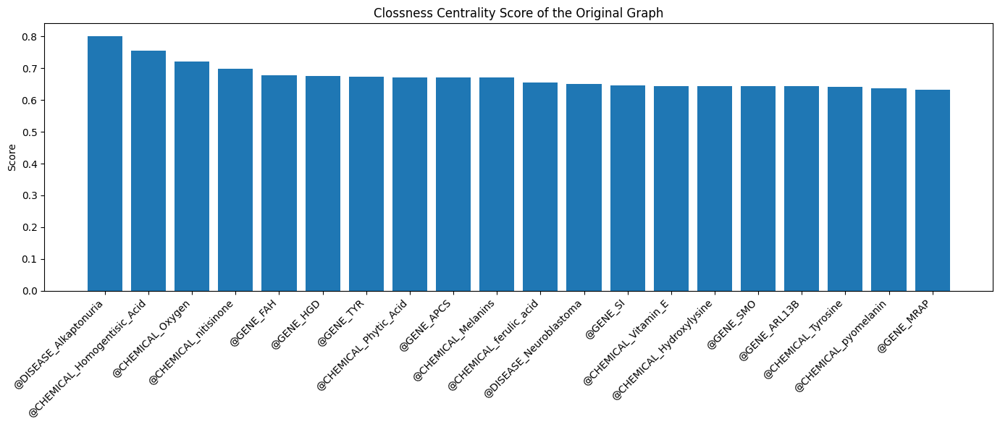

In [113]:
oricloseness = nx.closeness_centrality(originalGraph, distance='score')
plot_top_and_specific_entities(oricloseness, specific_entities=None, top_n=20, title="Clossness Centrality Score of the Original Graph")

### Extended graph

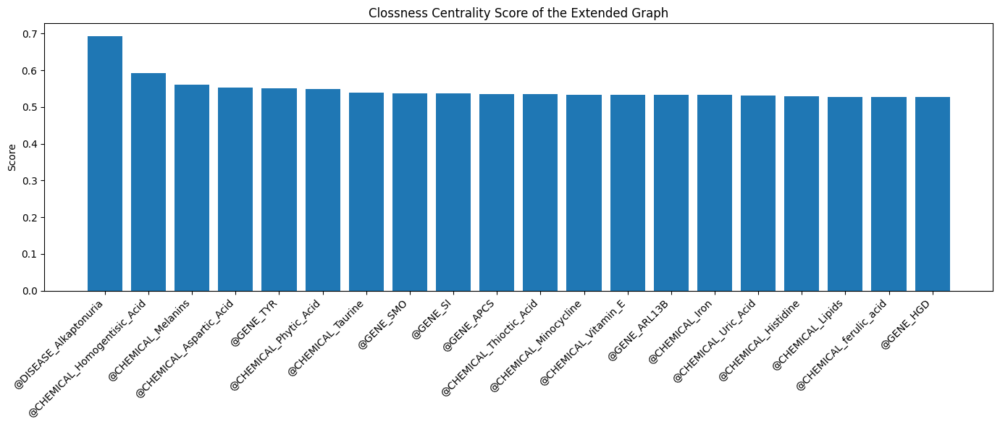

In [114]:
lv1closeness = nx.closeness_centrality(filteredlv1graph, distance='score')
plot_top_and_specific_entities(lv1closeness, specific_entities=None, top_n=20, title="Clossness Centrality Score of the Extended Graph")

### High confident graph

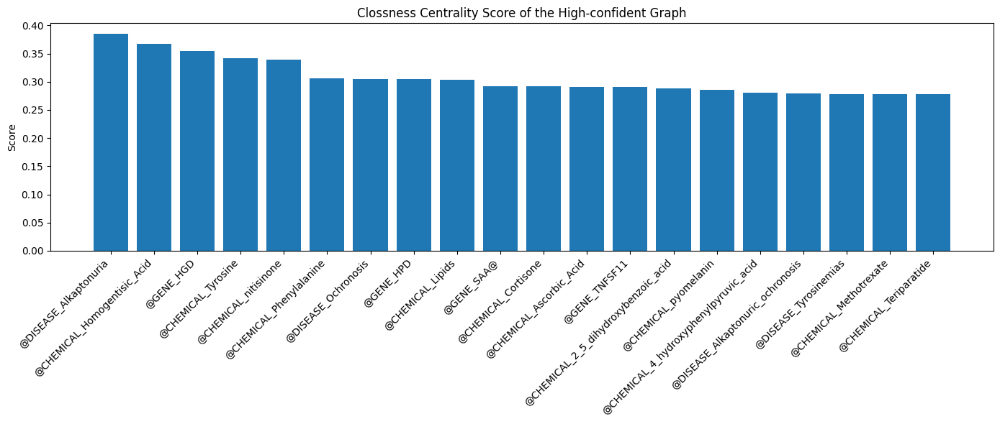

In [115]:
hicloseness = nx.closeness_centrality(highconfgraph, distance='score')
plot_top_and_specific_entities(hicloseness, specific_entities=None, top_n=20, title="Clossness Centrality Score of the High-confident Graph")

## PageRank persionalized from Alkaptonuria

### Extended network

In [95]:
# page rank 
import networkx as nx

# Define the node of interest
node_of_interest = '@DISEASE_Alkaptonuria'

# Personalized PageRank vector: only the node of interest has nonzero weight
personalization = {n: 0 for n in lv1exgraph.nodes()}
personalization[node_of_interest] = 1.0

# Compute Personalized PageRank
pagerank_scores_lv1 = nx.pagerank(filteredlv1graph, alpha=0.85, personalization=personalization, weight='score')

# Sort nodes by their PageRank score (descending)

pprfromallv1 = dict(sorted(pagerank_scores_lv1.items(), key=lambda item: item[1], reverse=True))
del pprfromallv1['@DISEASE_Alkaptonuria']
pprfromalgenelv1 = dict()
pprfromalchemlv1 = dict()
pprfromaldilv1 = dict()

# Display top connected nodes to 'A'
# print("Top nodes most connected to node @DISEASE_Alkaptonuria (via PageRank):")
for node, score in pprfromallv1.items():
    if '@GENE' in node:
        pprfromalgenelv1[node] = score

    if '@CHEMICAL' in node:
        pprfromalchemlv1[node] = score

    if '@DISEASE' in node and node != '@DISEASE_Alkaptonuria':
        pprfromaldilv1[node] = score
        
    # print(f"{node}: {score:.4f}")

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")


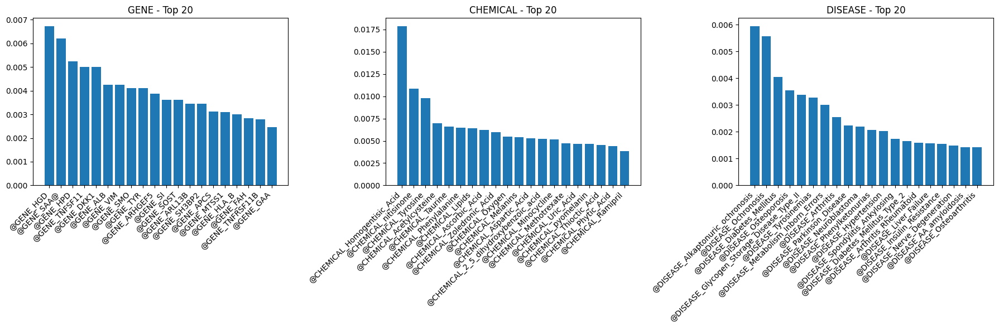

In [120]:
plot_top_20_entities_3dicts(pprfromalgenelv1, pprfromalchemlv1, pprfromaldilv1)

### High confident network

In [121]:
# page rank 
import networkx as nx

# Define the node of interest
node_of_interest = '@DISEASE_Alkaptonuria'

# Personalized PageRank vector: only the node of interest has nonzero weight
personalization = {n: 0 for n in highconfgraph.nodes()}
personalization[node_of_interest] = 1.0

# Compute Personalized PageRank
pagerank_scores_hi = nx.pagerank(highconfgraph, alpha=0.85, personalization=personalization, weight='score')

# Sort nodes by their PageRank score (descending)
pprfromalhi = dict(sorted(pagerank_scores_hi.items(), key=lambda item: item[1], reverse=True))
del pprfromalhi['@DISEASE_Alkaptonuria']
pprfromalgenehi = dict()
pprfromalchemhi = dict()
pprfromaldihi = dict()

# Display top connected nodes to 'A'
# print("Top nodes most connected to node @DISEASE_Alkaptonuria (via PageRank):")
for node, score in pprfromalhi.items():
    if '@GENE' in node:
        pprfromalgenehi[node] = score

    if '@CHEMICAL' in node:
        pprfromalchemhi[node] = score

    if '@DISEASE' in node and node != '@DISEASE_Alkaptonuria':
        pprfromaldihi[node] = score
        
    # print(f"{node}: {score:.4f}")

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")


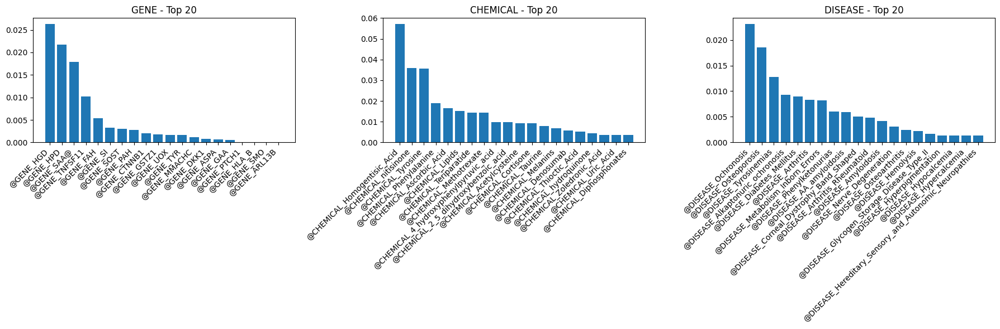

In [123]:
plot_top_20_entities_3dicts(pprfromalgenehi, pprfromalchemhi, pprfromaldihi)

## Personalize from nodes to Alkaptonuria

#### Define function

In [124]:
import networkx as nx

def personalized_pagerank_to_node(G, target_node='Alkaptonuria', source_prefix='@GENE'):
    """
    For each @GENE node, compute the personalized PageRank and extract the score of 'Alkaptonuria'.

    Parameters:
        G (networkx.DiGraph): Directed graph.
        target_node (str): The node for which we want PPR values.
        gene_prefix (str): Prefix identifying gene nodes.

    Returns:
        dict: Mapping from @GENE node to the PageRank score of 'Alkaptonuria'.
    """
    if target_node not in G:
        raise ValueError(f"Target node '{target_node}' not found in the graph.")

    gene_nodes = [n for n in G.nodes if n.startswith(source_prefix)]
    result = {}

    for gene in gene_nodes:
        personalization = {n: 0 for n in G.nodes}
        personalization[gene] = 1.0

        # Compute Personalized PageRank from this gene
        ppr = nx.pagerank(G, personalization=personalization, weight='score')

        # Extract score for 'Alkaptonuria'
        result[gene] = ppr.get(target_node, 0.0)

    return result

### Original network

In [ ]:
origenepprtoal = personalized_pagerank_to_node(originalGraph, target_node='@DISEASE_Alkaptonuria', source_prefix='@') 
# del genepprtoal['@DISEASE_Alkaptonuria']

In [ ]:
oripprtoalgene = dict()
oripprtoalchem = dict()
oripprtoaldi = dict() 
for gene, score in dict(sorted(origenepprtoal.items(), key=lambda item: item[1], reverse=True)).items():
    if '@GENE' in gene:
        oripprtoalgene[gene] = score
    if '@CHEMICAL' in gene:
        oripprtoalchem[gene] = score 
    if '@DISEASE' in gene:
        oripprtoaldi[gene] = score
    print(f"{gene}: {score:.4f}") 

In [ ]:
plot_top_per_type(oripprtoalgene, oripprtoalchem, oripprtoaldi)

### Extended network

In [125]:
lv1genepprtoal = personalized_pagerank_to_node(filteredlv1graph, target_node='@DISEASE_Alkaptonuria', source_prefix='@') 
# del genepprtoal['@DISEASE_Alkaptonuria']

In [126]:
lv1pprtoalgene = dict()
lv1pprtoalchem = dict()
lv1pprtoaldi = dict() 
for gene, score in dict(sorted(lv1genepprtoal.items(), key=lambda item: item[1], reverse=True)).items():
    if '@GENE' in gene:
        lv1pprtoalgene[gene] = score
    if '@CHEMICAL' in gene:
        lv1pprtoalchem[gene] = score 
    if '@DISEASE' in gene and gene != '@DISEASE_Alkaptonuria':
        lv1pprtoaldi[gene] = score
    print(f"{gene}: {score:.4f}") 

@DISEASE_Alkaptonuria: 0.2723
@VARIANT_c.926G>T_HGD_human: 0.2314
@VARIANT_c.557T>A_HGD_human: 0.2314
@VARIANT_c.1_8460_282+6727del_HGD_human: 0.2314
@VARIANT_c.1007_1709_1188+1121del_HGD_human: 0.2314
@VARIANT_p.F329C_HGD_human: 0.2314
@VARIANT_c.IVS7+1G>C_HGD_human: 0.2314
@VARIANT_c.650_85A>G_HGD_human: 0.2314
@VARIANT_c.158G>A_HGD_human: 0.2314
@VARIANT_c.1057A>C_HGD_human: 0.2314
@VARIANT_p.G251D_HGD_human: 0.2314
@VARIANT_c.614G>A_HGD_human: 0.2314
@VARIANT_c.775_1915_879+1293del_HGD_human: 0.2314
@VARIANT_c.15G>A_HGD_human: 0.2314
@VARIANT_c.1081G>A_HGD_human: 0.2314
@VARIANT_c.948G>T_HGD_human: 0.2314
@VARIANT_c.1273C>A_HGD_human: 0.2314
@VARIANT_c.847T>C_HGD_human: 0.2314
@VARIANT_c.533T>G_HGD_human: 0.2314
@VARIANT_c.551_552insG_HGD_human: 0.2314
@VARIANT_c.1046T>G_HGD_human: 0.2314
@VARIANT_c.87+1G>A_HGD_human: 0.2314
@VARIANT_c.IVS5+3A>C_HGD_human: 0.2314
@VARIANT_c.115delG_HGD_human: 0.2314
@VARIANT_c.500C>T_HGD_human: 0.2314
@VARIANT_p.V316F_HGD_human: 0.2314
@VARIANT_c.8

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")


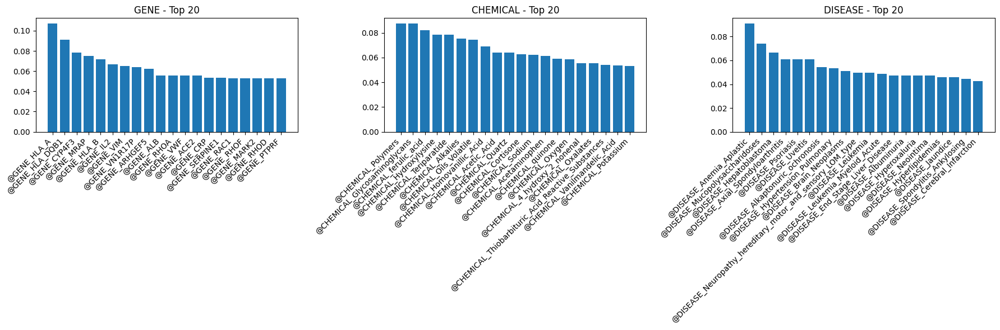

In [127]:
plot_top_20_entities_3dicts(lv1pprtoalgene, lv1pprtoalchem, lv1pprtoaldi)

### High confident network

In [128]:
higenepprtoal = personalized_pagerank_to_node(highconfgraph, target_node='@DISEASE_Alkaptonuria', source_prefix='@') 
# del genepprtoal['@DISEASE_Alkaptonuria']

In [129]:
hipprtoalgene = dict()
hipprtoalchem = dict()
hipprtoaldi = dict() 
for gene, score in dict(sorted(higenepprtoal.items(), key=lambda item: item[1], reverse=True)).items():
    if '@GENE' in gene:
        hipprtoalgene[gene] = score
    if '@CHEMICAL' in gene:
        hipprtoalchem[gene] = score 
    if '@DISEASE' in gene and gene != '@DISEASE_Alkaptonuria':
        hipprtoaldi[gene] = score
    # print(f"{gene}: {score:.4f}") 

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")


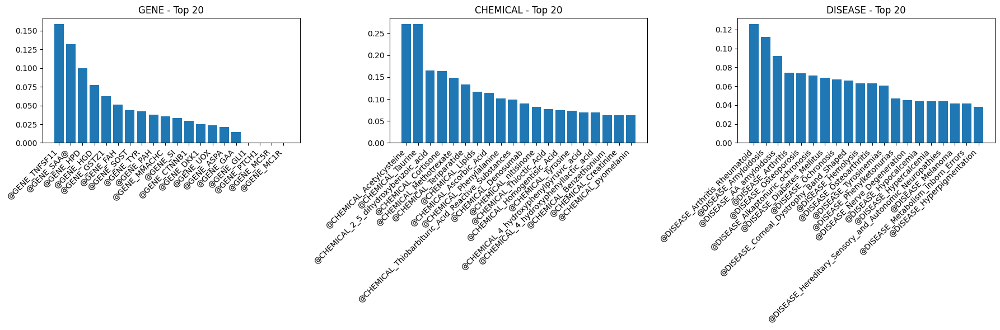

In [131]:
plot_top_20_entities_3dicts(hipprtoalgene, hipprtoalchem, hipprtoaldi)

## Maximum flow

### Define functions 

In [132]:
import networkx as nx

def compute_max_flow_to_target_disease(G, target_disease, disease_prefix='@DISEASE', weight='score', switch=False):
    """
    Compute maximum flow from each other disease node to a target disease in a directed, weighted graph.

    Parameters:
    - G: NetworkX DiGraph
    - target_disease: node name of the disease of interest (sink)
    - disease_prefix: prefix to identify disease nodes (default: '@DISEASE')
    - weight: edge weight attribute used as capacity (default: 'weight')

    Returns:
    - flow_results: dict {source_disease: max_flow_value}
    """
    if not G.is_directed():
        raise ValueError("Graph must be directed.")
    if target_disease not in G:
        raise ValueError("Target disease not found in graph.")

    flow_results = {}

    # Identify all disease nodes except the target
    source_diseases = [
        node for node in G.nodes()
        if str(node).startswith(disease_prefix) and node != target_disease
    ]

    for source in source_diseases:
        try:
            if switch:
                # Switch source and target for max flow calculation
                flow_value, _ = nx.maximum_flow(G, target_disease, source, capacity=weight)
            else:
                # Normal max flow calculation
                flow_value, _ = nx.maximum_flow(G, source, target_disease, capacity=weight)
            flow_results[source] = flow_value
        except (nx.NetworkXError, nx.NetworkXUnfeasible):
            flow_results[source] = 0.0

    return flow_results


### Filtered extended network 

In [134]:
node_to_al_flow = compute_max_flow_to_target_disease(
    filteredlv1graph.to_directed(),
    target_disease='@DISEASE_Alkaptonuria',
    disease_prefix='@',
    weight='score'
)

In [135]:
print("Maximum flow values to @DISEASE_Alkaptonuria:")
# geneppr.items(), key=lambda item: item[1], reverse=True 
flowtoalgene = dict()
flowtoalchem = dict()
flowtoaldi = dict()
for node, flow in dict(sorted(node_to_al_flow.items(), key=lambda item: item[1], reverse=True)).items():
    if node.startswith("@GENE"):
        flowtoalgene[node] = flow 
    if node.startswith("@CHEMICAL"):
        flowtoalchem[node] = flow
    if node.startswith("@DISEASE") and node != '@DISEASE_Alkaptonuria':
        flowtoaldi[node] = flow
    # print(f"{node}: {flow:.4f}") 

Maximum flow values to @DISEASE_Alkaptonuria:


/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")


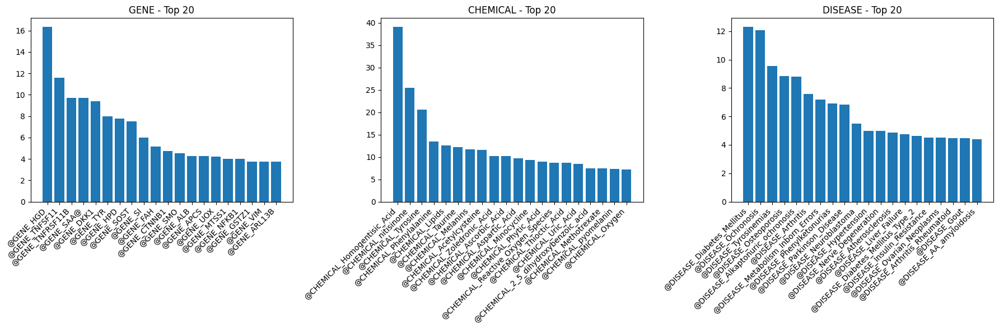

In [136]:
plot_top_20_entities_3dicts(flowtoalgene, flowtoalchem, flowtoaldi)

### High-confident network

In [139]:
node_to_al_flow_hi = compute_max_flow_to_target_disease(
    highconfgraph.to_directed(),
    target_disease='@DISEASE_Alkaptonuria',
    disease_prefix='@',
    weight='score'
)

In [140]:
print("Maximum flow values to @DISEASE_Alkaptonuria:")
# geneppr.items(), key=lambda item: item[1], reverse=True 
flowtoalgenehi = dict()
flowtoalchemhi = dict()
flowtoaldihi = dict()
for node, flow in dict(sorted(node_to_al_flow_hi.items(), key=lambda item: item[1], reverse=True)).items():
    if node.startswith("@GENE"):
        flowtoalgenehi[node] = flow 
    if node.startswith("@CHEMICAL"):
        flowtoalchemhi[node] = flow
    if node.startswith("@DISEASE") and node != '@DISEASE_Alkaptonuria':
        flowtoaldihi[node] = flow
    # print(f"{node}: {flow:.4f}") 

Maximum flow values to @DISEASE_Alkaptonuria:


/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")
/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/2491794532.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(keys, rotation=45, ha="right")


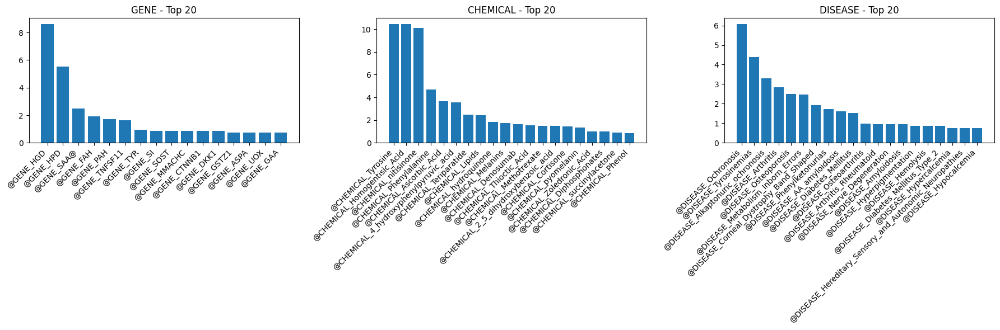

In [148]:
plot_top_20_entities_3dicts(flowtoalgenehi, flowtoalchemhi, flowtoaldihi)

## Metapath Chemical-Gene-Disease analysis 

### Define functions

In [149]:
import math
import numpy as np
import networkx as nx
from typing import Dict, List, Tuple, Optional, Iterable

# ----------------------------
# Helpers
# ----------------------------

def _node_type(n: str) -> Optional[str]:
    """Infer type from name prefix."""
    if isinstance(n, str):
        for pfx, t in [("@CHEMICAL", "chemical"),
                       ("@GENE", "gene"),
                       ("@DISEASE", "disease"),
                       ("@VARIANT", "variant")]:
            if n.startswith(pfx):
                return t
    return None

def _collect_by_type(G: nx.Graph) -> Dict[str, List[str]]:
    types = {"chemical": [], "gene": [], "disease": [], "variant": []}
    for n in G.nodes():
        t = _node_type(n)
        if t in types:
            types[t].append(n)
    return types

def _row_normalize(A: np.ndarray) -> np.ndarray:
    A = A.astype(float, copy=True)
    rs = A.sum(axis=1, keepdims=True)
    rs[rs == 0] = 1.0  # keep zero-rows as zeros
    return A / rs

def _build_bipartite_matrix(
    G: nx.Graph,
    left_nodes: List[str],
    right_nodes: List[str],
    weight_attr: Optional[str] = None
) -> np.ndarray:
    """Construct a (|left| x |right|) adjacency matrix using edge weights or 1s."""
    li = {n: i for i, n in enumerate(left_nodes)}
    rj = {n: j for j, n in enumerate(right_nodes)}
    A = np.zeros((len(left_nodes), len(right_nodes)), dtype=float)

    # For directed graphs, we allow either direction (C<->G, G<->D) as 'connected'
    # since the metapath semantics are type-based. Adjust if you need directionality.
    def add_edge(u, v, w):
        if u in li and v in rj:
            A[li[u], rj[v]] += w
        if v in li and u in rj:
            A[li[v], rj[u]] += w

    for u, v, data in G.edges(data=True):
        if u not in li and u not in rj and v not in li and v not in rj:
            continue
        w = float(data.get(weight_attr, 1.0)) if weight_attr else 1.0
        if w <= 0:
            continue
        add_edge(u, v, w)

    return A

# ----------------------------
# Core: HeteSim for C–G–D
# ----------------------------

def hete_cgd_rank(
    G: nx.Graph,
    target_disease: str,
    *,
    weight_attr: Optional[str] = 'score',
    exclude_variants: bool = True,
    top_k: Optional[int] = None
) -> List[Tuple[str, float]]:
    """
    Rank chemicals for a target disease using HeteSim along the C–G–D metapath.

    Parameters
    ----------
    G : nx.Graph or nx.DiGraph
        Heterogeneous graph whose node names start with '@CHEMICAL', '@GENE', '@DISEASE', '@VARIANT'.
    target_disease : str
        Node name of the target disease (must start with '@DISEASE').
    weight_attr : str or None
        Edge attribute to use as edge weight (strength). None => unweighted (1s).
    exclude_variants : bool
        If True, nodes starting with '@VARIANT' are ignored.
    top_k : int or None
        Return only the top-k chemicals (sorted by score). None => all.

    Returns
    -------
    List[Tuple[chemical_node, hete_score]]
        Sorted in descending score. Zero scores are kept (you can filter them out if desired).
    """
    if not isinstance(target_disease, str) or not target_disease.startswith("@DISEASE"):
        raise ValueError("target_disease must be a string node starting with '@DISEASE'.")

    groups = _collect_by_type(G)
    chemicals = groups["chemical"]
    genes = groups["gene"]
    diseases = groups["disease"]

    if exclude_variants:
        # Just ignore variants; metapath is C–G–D
        pass

    if target_disease not in diseases:
        raise ValueError(f"Target disease '{target_disease}' not found among disease nodes.")

    if not chemicals or not genes:
        return []

    # Build adjacency for C-G and G-D
    A_CG = _build_bipartite_matrix(G, chemicals, genes, weight_attr=weight_attr)
    # print(A_CG)
    A_GD = _build_bipartite_matrix(G, genes, diseases,  weight_attr=weight_attr)
    # print(A_GD)

    # Transition probabilities
    P_CG = _row_normalize(A_CG)        # C -> G
    P_DG = _row_normalize(A_GD.T)      # D -> G  (reverse of G->D)

    # Build one-hot for target disease
    d_index = {d: j for j, d in enumerate(diseases)}[target_disease]
    e_d = np.zeros((1, len(diseases)), dtype=float)
    e_d[0, d_index] = 1.0

    # Right-half distribution (disease to genes along reverse half)
    R_d = e_d @ P_DG  # shape: 1 x |G|

    # Pre-normalize R_d for cosine (avoid divide-by-zero)
    r_norm = np.linalg.norm(R_d)
    # If target has no G connections, all scores are zero.
    if r_norm == 0.0:
        return [(c, 0.0) for c in chemicals]

    # Compute scores for all chemicals
    scores: List[Tuple[str, float]] = []
    for i, c in enumerate(chemicals):
        # Left-half distribution (chemical to genes)
        L_c = P_CG[i:i+1, :]  # 1 x |G|
        l_norm = np.linalg.norm(L_c)
        if l_norm == 0.0:
            sim = 0.0
        else:
            sim = float((L_c @ R_d.T) / (l_norm * r_norm))  # cosine similarity
        # Numerical guard
        if not math.isfinite(sim):
            sim = 0.0
        scores.append((c, sim))

    scores.sort(key=lambda x: x[1], reverse=True)
    return scores[:top_k] if (top_k is not None and top_k > 0) else scores


# ----------------------------
# Optional: full CxD score matrix
# ----------------------------

def hete_cgd_matrix(
    G: nx.Graph,
    *,
    weight_attr: Optional[str] = None,
    exclude_variants: bool = True
) -> Tuple[np.ndarray, List[str], List[str]]:
    """
    Compute a full HeteSim score matrix for all (chemical, disease) pairs along C–G–D.

    Returns
    -------
    M : np.ndarray  (|C| x |D|)
        HeteSim scores.
    chemicals : List[str]
    diseases : List[str]
    """
    groups = _collect_by_type(G)
    chemicals = groups["chemical"]
    genes = groups["gene"]
    diseases = groups["disease"]

    if exclude_variants:
        pass

    if not (chemicals and genes and diseases):
        return np.zeros((0, 0)), chemicals, diseases

    A_CG = _build_bipartite_matrix(G, chemicals, genes, weight_attr=weight_attr)
    A_GD = _build_bipartite_matrix(G, genes, diseases,  weight_attr=weight_attr)

    P_CG = _row_normalize(A_CG)   # C -> G
    P_DG = _row_normalize(A_GD.T) # D -> G

    # Cosine similarity between each row of P_CG and each row of P_DG
    # Normalize rows
    def safe_norm_rows(M):
        norms = np.linalg.norm(M, axis=1, keepdims=True)
        norms[norms == 0] = 1.0
        return M / norms

    L = safe_norm_rows(P_CG)  # |C| x |G|
    R = safe_norm_rows(P_DG)  # |D| x |G|
    # HeteSim(C,D) = cosine( L_c , R_d )
    # => M = L @ R^T
    M = L @ R.T
    return M, chemicals, diseases

### Extend network 

In [150]:
# Rank chemicals for a target disease
scores = hete_cgd_rank(filteredlv1graph, "@DISEASE_Alkaptonuria", top_k=None)
hetesimdict = dict()
for chem, s in scores:
    print(chem, round(s, 4))
    hetesimdict[chem] = round(s, 4)


# Full matrix
M, C, D = hete_cgd_matrix(filteredlv1graph)
print("\nChemicals:", C)
print("Diseases :", D)
print("Score matrix (rows=C, cols=D):\n", np.round(M, 4))

@CHEMICAL_Homogentisic_Acid 0.5587
@CHEMICAL_Carbon 0.3831
@CHEMICAL_Tyrosine 0.3791
@CHEMICAL_nitisinone 0.3452
@CHEMICAL_pyrazolone 0.3451
@CHEMICAL_Fluorine 0.3451
@CHEMICAL_kaempferol 0.3451
@CHEMICAL_Arginine 0.3056
@CHEMICAL_Cysteine 0.3056
@CHEMICAL_Peptides 0.2993
@CHEMICAL_Glyoxal 0.2593
@CHEMICAL_Lysine 0.2593
@CHEMICAL_Bilirubin 0.2593
@CHEMICAL_Bromcresol_Purple 0.2593
@CHEMICAL_4_hydroxy_2_nonenal 0.2593
@CHEMICAL_Denosumab 0.2593
@CHEMICAL_4_hydroxyphenylpyruvic_acid 0.2453
@CHEMICAL_Glutamic_Acid 0.2273
@CHEMICAL_Glucuronides 0.2273
@CHEMICAL_Sulfates 0.2273
@CHEMICAL_Lipids 0.2117
@CHEMICAL_Phytic_Acid 0.1994
@CHEMICAL_Oxygen 0.1891
@CHEMICAL_Platinum 0.1834
@CHEMICAL_Lapatinib 0.1833
@CHEMICAL_Isoflavones 0.1833
@CHEMICAL_Levodopa 0.1729
@CHEMICAL_succinylacetone 0.1729
@CHEMICAL_Carbohydrates 0.1729
@CHEMICAL_Melanins 0.1729
@CHEMICAL_Sulfhydryl_Compounds 0.1729
@CHEMICAL_4_((2_carboxyethyl)hydroxyphosphinyl)_3_oxobutyrate 0.1729
@CHEMICAL_Cholesterol 0.1729
@CHEMICAL

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/1665326467.py:148: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  sim = float((L_c @ R_d.T) / (l_norm * r_norm))  # cosine similarity


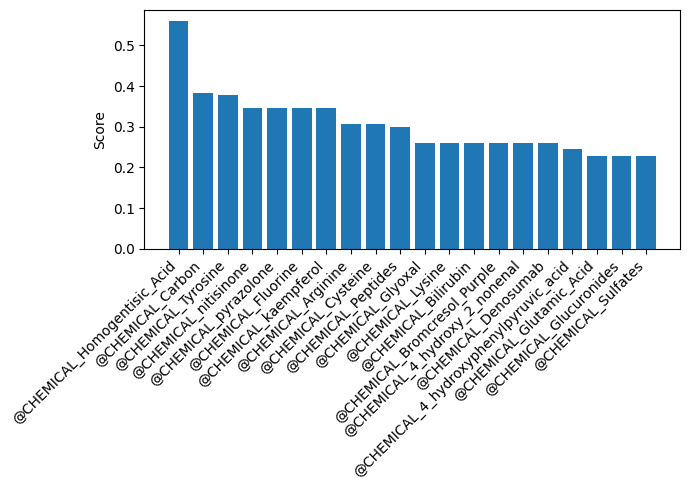

In [188]:
plot_top_and_specific_entities(hetesimdict, [], top_n=20, title="")


### High confident network 

In [152]:
# Rank chemicals for a target disease
scoreshi = hete_cgd_rank(highconfgraph, "@DISEASE_Alkaptonuria", top_k=None)
hetesimdicthi = dict()
for chem, s in scoreshi:
    print(chem, round(s, 4))
    hetesimdicthi[chem] = round(s, 4)


# Full matrix
M, C, D = hete_cgd_matrix(highconfgraph)
print("\nChemicals:", C)
print("Diseases :", D)
print("Score matrix (rows=C, cols=D):\n", np.round(M, 4))

@CHEMICAL_Homogentisic_Acid 0.8788
@CHEMICAL_nitisinone 0.6911
@CHEMICAL_4_hydroxyphenylpyruvic_acid 0.5773
@CHEMICAL_Tyrosine 0.5021
@CHEMICAL_Phenylalanine 0.3803
@CHEMICAL_Carbon_Dioxide 0.0
@CHEMICAL_Ascorbic_Acid 0.0
@CHEMICAL_Hydrogen_Peroxide 0.0
@CHEMICAL_Lipids 0.0
@CHEMICAL_Phenol 0.0
@CHEMICAL_Cortisone 0.0
@CHEMICAL_succinylacetone 0.0
@CHEMICAL_Benzethonium 0.0
@CHEMICAL_Melanins 0.0
@CHEMICAL_pyomelanin 0.0
@CHEMICAL_Uric_Acid 0.0
@CHEMICAL_Dopamine 0.0
@CHEMICAL_Histidine 0.0
@CHEMICAL_Minocycline 0.0
@CHEMICAL_Creatinine 0.0
@CHEMICAL_2_5_dihydroxybenzoic_acid 0.0
@CHEMICAL_Taurine 0.0
@CHEMICAL_Acetylcysteine 0.0
@CHEMICAL_Thioctic_Acid 0.0
@CHEMICAL_hydroquinone 0.0
@CHEMICAL_Methotrexate 0.0
@CHEMICAL_Homovanillic_Acid 0.0
@CHEMICAL_Orotic_Acid 0.0
@CHEMICAL_Vanilmandelic_Acid 0.0
@CHEMICAL_Glycogen 0.0
@CHEMICAL_Diphosphonates 0.0
@CHEMICAL_quinone 0.0
@CHEMICAL_Asparagine 0.0
@CHEMICAL_Denosumab 0.0
@CHEMICAL_Thiobarbituric_Acid_Reactive_Substances 0.0
@CHEMICAL_Te

/var/folders/01/v0p4sfw945j32p3yvg67p6cc0000gn/T/ipykernel_14113/1665326467.py:148: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  sim = float((L_c @ R_d.T) / (l_norm * r_norm))  # cosine similarity


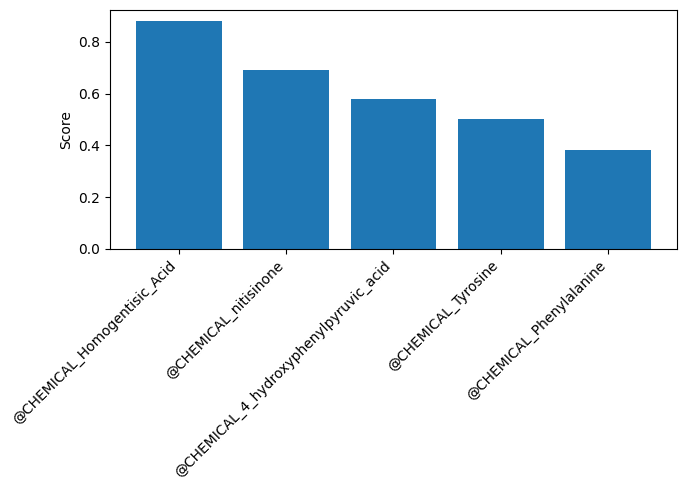

In [192]:
plot_top_and_specific_entities(hetesimdicthi, [], top_n=5, title="")

## Disease similarity 

### Define functions 

In [173]:
import math
import numpy as np
import networkx as nx
import scipy.sparse as sp
from sklearn.preprocessing import normalize
from sklearn.metrics.pairwise import cosine_similarity
from collections import defaultdict
from math import comb

# ---------- Helpers ----------

def _node_type(n):
    if isinstance(n, str):
        if n.startswith("@DISEASE"): return "disease"
        if n.startswith("@GENE"):    return "gene"
        if n.startswith("@CHEMICAL"):return "chemical"
    return None

def _collect_neighbors(G, node, kinds, in_edges=True, out_edges=True):
    """Return neighbors of specified kinds, respecting direction options."""
    neigh = []
    if G.is_directed():
        if in_edges:
            for u, v, data in G.in_edges(node, data=True):
                if _node_type(u) in kinds:
                    neigh.append((u, data))
        if out_edges:
            for u, v, data in G.out_edges(node, data=True):
                if _node_type(v) in kinds:
                    neigh.append((v, data))
    else:
        for nbr, data in G[node].items():
            if _node_type(nbr) in kinds:
                neigh.append((nbr, data))
    return neigh

def _build_incidence(G, diseases, items, item_kind,
                     in_edges=True, out_edges=True,
                     use_weights=False, signed=False):
    """Build D x I sparse matrix: rows=diseases, cols=items (genes or chemicals)."""
    d2i = {d:i for i,d in enumerate(diseases)}
    i2j = {it:j for j,it in enumerate(items)}
    rows, cols, vals = [], [], []

    for d in diseases:
        row = d2i[d]
        neigh = _collect_neighbors(G, d, {item_kind}, in_edges=in_edges, out_edges=out_edges)
        agg = defaultdict(float)
        for nbr, data in neigh:
            val = 1.0
            if use_weights and 'score' in data:
                # print("Use score")
                val = float(data['score'])
            if signed and 'sign' in data:
                s = data['sign']
                if isinstance(s, str):
                    s = 1.0 if s.lower().startswith('+') else -1.0
                val *= float(s)
            agg[nbr] += val
        for nbr, v in agg.items():
            if nbr in i2j:
                rows.append(row)
                cols.append(i2j[nbr])
                vals.append(v)

    mat = sp.coo_matrix((vals, (rows, cols)), shape=(len(diseases), len(items)))
    return mat.tocsr()

def _tfidf_rows(X):
    # L2 row-normalize (TF)
    X_tf = normalize(X, norm='l2', axis=1, copy=True)
    # IDF on columns
    df = np.asarray((X > 0).sum(axis=0)).ravel()
    idf = np.log((X.shape[0]) / (1.0 + df))
    return X_tf @ sp.diags(idf)

def _cosine_sim(X, tfidf=False):
    Xw = _tfidf_rows(X) if tfidf else normalize(X, norm='l2', axis=1, copy=True)
    return cosine_similarity(Xw, dense_output=False)  # sparse

def _pathsim(A):
    # A: D x I (weights allowed). M = A A^T
    M = (A @ A.T).tocsr()
    diag = M.diagonal()
    rows, cols = M.nonzero()
    data = M.data
    ps_vals = []
    for v, i, j in zip(data, rows, cols):
        denom = diag[i] + diag[j]
        ps_vals.append(0.0 if denom == 0 else 2.0 * v / denom)
    return sp.csr_matrix((ps_vals, (rows, cols)), shape=M.shape)

def _hypergeom_overlap(A):
    """
    Binary overlap significance (via items). A is D x I binary.
    Uses survival function approximation for moderate sizes.
    Weight = -log10(p-value). Non-overlapping pairs omitted (weight=0).
    """
    A_bin = A.copy().astype(bool).astype(int).tocsr()
    M = (A_bin @ A_bin.T).tocsr()  # pair overlaps
    n_items = A.shape[1]
    diag = A_bin.sum(axis=1).A1  # set sizes

    rows, cols = M.nonzero()
    ks = M.data
    vals = []
    for k, i, j in zip(ks, rows, cols):
        if i == j or k == 0:
            vals.append(0.0)
            continue
        Ki = diag[i]; Kj = diag[j]
        # compute P(X >= k) for Hypergeom(N=n_items, K=Ki, n=Kj)
        # naive sum of pmf tails; OK for typical sparse projections
        p = 0.0
        max_x = int(min(Ki, Kj))
        # guard small combinatorics; use logs if needed
        for x in range(k, max_x+1):
            num = comb(Ki, x) * comb(n_items - Ki, Kj - x)
            den = comb(n_items, Kj)
            p += num / den
        vals.append(0.0 if p <= 0 else -math.log10(p))
    return sp.csr_matrix((vals, (rows, cols)), shape=M.shape)

def _combine(mats, weights=None):
    mats = [m.tocsr() for m in mats if m is not None]
    if not mats: return None
    if weights is None:
        weights = [1.0/len(mats)]*len(mats)
    out = mats[0].multiply(weights[0])
    for m, w in zip(mats[1:], weights[1:]):
        out = out + m.multiply(w)
    return out

def _topk_per_row(S, k):
    if k is None: return S.tocsr()
    S = S.tolil()
    n = S.shape[0]
    for i in range(n):
        row = S.rows[i]; data = S.data[i]
        # drop self-loop
        for idx, j in enumerate(row):
            if j == i:
                row.pop(idx); data.pop(idx)
                break
        if len(row) > k:
            idxs = np.argpartition(data, -k)[-k:]
            keep = set(np.array(row)[idxs])
            mask = [j in keep for j in row]
            S.rows[i] = list(np.array(row)[mask])
            S.data[i] = list(np.array(data)[mask])
    return S.tocsr()

# ---------- Main entry ----------

def build_disease_similarity(
    G: nx.Graph,
    via=("gene","chemical"),                  # which channels to use
    method=("cosine_tfidf", "pathsim"),      # similarity methods to combine
    in_edges=True, out_edges=True,           # direction handling
    use_weights=True, signed=False,         # edge attributes: weight/sign
    weights_by_channel=None,                 # e.g., {"gene":0.6,"chemical":0.4}
    weights_by_method=None,                  # e.g., {"cosine_tfidf":0.5,"pathsim":0.5}
    hypergeom_binary=False,                  # if True, use hypergeometric for a channel (binary)
    topk=20                                  # keep top-k neighbors per disease (None to skip)
):
    """
    Returns:
      H (nx.Graph): disease–disease weighted similarity graph
      S (scipy.sparse.csr_matrix): similarity matrix aligned to disease order
      diseases (list): disease node order used in S
    """
    # collect nodes
    diseases = [n for n in G.nodes if _node_type(n) == "disease"]
    genes    = [n for n in G.nodes if _node_type(n) == "gene"]
    chems    = [n for n in G.nodes if _node_type(n) == "chemical"]

    if not diseases:
        raise ValueError("No @DISEASE nodes found.")
    if not genes and "gene" in via:
        via = tuple(x for x in via if x != "gene")
    if not chems and "chemical" in via:
        via = tuple(x for x in via if x != "chemical")
    if not via:
        raise ValueError("No projection channels available (no genes/chemicals present).")

    # default weights
    if weights_by_channel is None:
        weights_by_channel = {ch: 1.0/len(via) for ch in via}
    if weights_by_method is None:
        unique_methods = tuple(method) if isinstance(method, (list, tuple)) else (method,)
        weights_by_method = {m: 1.0/len(unique_methods) for m in unique_methods}

    # build per-channel similarity
    channel_sims = []
    for ch in via:
        if ch == "gene":
            A = _build_incidence(G, diseases, genes, "gene",
                                 in_edges, out_edges, use_weights, signed)
        elif ch == "chemical":
            A = _build_incidence(G, diseases, chems, "chemical",
                                 in_edges, out_edges, use_weights, signed)
        else:
            continue

        per_methods = []
        mlist = tuple(method) if isinstance(method, (list, tuple)) else (method,)

        for m in mlist:
            if m == "cosine":
                per_methods.append(_cosine_sim(A, tfidf=False))
            elif m == "cosine_tfidf":
                per_methods.append(_cosine_sim(A, tfidf=True))
            elif m == "pathsim":
                per_methods.append(_pathsim(A))
            elif m == "hypergeom":
                per_methods.append(_hypergeom_overlap(A))
            else:
                raise ValueError(f"Unknown method: {m}")

        # combine methods for this channel
        m_weights = [weights_by_method[m] for m in mlist]
        ch_sim = _combine(per_methods, m_weights)
        # optional: mark weight by channel
        channel_sims.append(ch_sim.multiply(weights_by_channel[ch]))

    # combine channels
    S = _combine(channel_sims, None)
    if S is None:
        raise RuntimeError("Could not build any similarity matrix.")

    # sparsify (top-k) and symmetrize to be safe
    S = _topk_per_row(S, topk)
    S = 0.5 * (S + S.T)

    # build NetworkX graph
    H = nx.Graph()
    H.add_nodes_from(diseases)
    rows, cols = S.nonzero()
    for i, j, w in zip(rows, cols, S.data):
        if i < j and w > 0:
            H.add_edge(diseases[i], diseases[j], weight=float(w))

    return H, S.tocsr(), diseases


In [170]:
import numpy as np
import scipy.sparse as sp
import matplotlib.pyplot as plt

def _find_disease_index(diseases, focal_name="Alkaptonuria"):
    # exact (case-insensitive)
    for i, d in enumerate(diseases):
        if d.lower() == focal_name.lower():
            return i
    # exact after stripping prefix
    for i, d in enumerate(diseases):
        if d.replace("@DISEASE:", "").lower() == focal_name.lower():
            return i
    # substring fallback
    cand = [i for i, d in enumerate(diseases)
            if focal_name.lower() in d.lower()
            or focal_name.lower() in d.replace("@DISEASE:", "").lower()]
    if len(cand) == 1:
        return cand[0]
    if cand:
        names = [diseases[i] for i in cand]
        raise ValueError(f"Ambiguous '{focal_name}'. Candidates: {names}")
    raise ValueError(f"'{focal_name}' not found in diseases list.")

def plot_top_similar_diseases_vertical(
    S,
    diseases,
    focal_name="Alkaptonuria",
    k=15,
    min_sim=None,
    exclude_self=True,
    annotate=True,
    rotation=45,          # <— rotate x tick labels
    figsize=(12, 6),
    save_path=None,
):
    n = len(diseases)
    i = _find_disease_index(diseases, focal_name)

    # pull similarity row
    if isinstance(S, np.ndarray):
        if S.shape != (n, n): raise ValueError("Dense S shape must be (n,n).")
        sims = S[i, :].astype(float).ravel()
    elif sp.isspmatrix(S):
        S = S.tocsr()
        if S.shape != (n, n): raise ValueError("Sparse S shape must be (n,n).")
        sims = np.full(n, -np.inf, dtype=float)
        row = S.getrow(i)
        sims[row.indices] = row.data
    else:
        raise TypeError("S must be a NumPy array or scipy.sparse matrix.")

    if exclude_self:
        sims[i] = -np.inf

    # optional threshold
    idxs = np.arange(n)
    if min_sim is not None:
        mask = np.isfinite(sims) & (sims >= float(min_sim))
        idxs, sims = idxs[mask], sims[mask]

    if len(idxs) == 0:
        raise ValueError("No similar diseases found with current filters.")

    # rank desc and take top-k
    order = np.argsort(sims)[::-1]
    if k is not None and k > 0:
        order = order[:k]
    top_idxs = idxs[order]
    top_vals = sims[order]
    top_names = [diseases[j].replace("@DISEASE:", "") for j in top_idxs]

    # vertical bars
    fig, ax = plt.subplots(figsize=figsize)
    x = np.arange(len(top_names))
    bars = ax.bar(x, top_vals)   # default style/colors

    ax.set_xticks(x)
    ax.set_xticklabels(top_names, rotation=rotation, ha="right")  # <— rotated ticks
    ax.set_ylabel("Similarity")
    ax.set_title(f"Top similar nodes to {focal_name}")
    ax.margins(x=0.01)

    if annotate:
        for xi, v in zip(x, top_vals):
            ax.text(xi, v, f"{v:.3f}", va="bottom", ha="center")

    fig.tight_layout()
    if save_path:
        fig.savefig(save_path, bbox_inches="tight", dpi=150)

    return fig, ax, list(zip(top_names, top_vals))


### Extend graph

In [174]:
H, S, exdimaps = build_disease_similarity(filteredlv1graph)

(<Figure size 900x600 with 1 Axes>,
 <Axes: title={'center': 'Top similar nodes to @DISEASE_Alkaptonuria'}, ylabel='Similarity'>,
 [('@DISEASE_Ochronosis', 0.15650754052321583),
  ('@DISEASE_Tyrosinemias', 0.12572932008724177),
  ('@DISEASE_Diabetes_Mellitus', 0.12166037729386127),
  ('@DISEASE_Amyloidosis', 0.12140163986705159),
  ('@DISEASE_Arthritis', 0.12043266908908071),
  ('@DISEASE_Osteoporosis', 0.11858978289726468),
  ('@DISEASE_Alkaptonuric_ochronosis', 0.11563386980414735),
  ('@DISEASE_AA_amyloidosis', 0.09407986408561103),
  ('@DISEASE_Aortic_Valve_Stenosis', 0.09127323659350897),
  ('@DISEASE_Spondylitis_Ankylosing', 0.08362603750040457),
  ('@DISEASE_Parkinson_Disease', 0.08277006977258411),
  ('@DISEASE_Metabolism_Inborn_Errors', 0.08271709563681494),
  ('@DISEASE_Diabetes_Mellitus_Type_2', 0.07986620089839327),
  ('@DISEASE_Diabetes_Mellitus_Type_1', 0.07701571588859747),
  ('@DISEASE_Renal_Insufficiency', 0.0754734068449267),
  ('@DISEASE_Brain_Neoplasms', 0.072397851

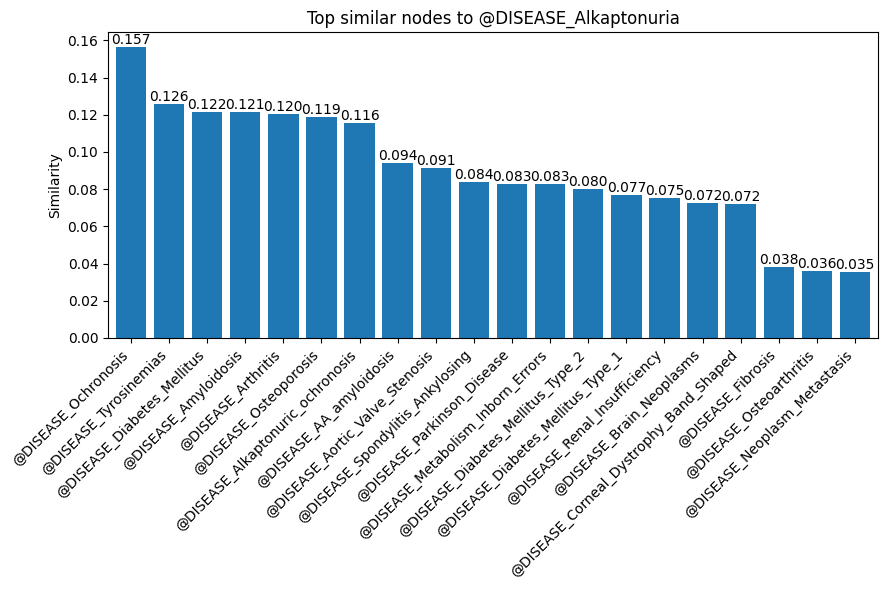

In [175]:
plot_top_similar_diseases_vertical(
    S,
    exdimaps,
    focal_name="@DISEASE_Alkaptonuria",
    k=20,
    min_sim=None,
    exclude_self=True,
    annotate=True,
    figsize=(9, 6),
    save_path=None,
)

### High confident network 

In [176]:
hiH, hiS, hidimaps = build_disease_similarity(highconfgraph)

(<Figure size 900x600 with 1 Axes>,
 <Axes: title={'center': 'Top similar nodes to @DISEASE_Alkaptonuria'}, ylabel='Similarity'>,
 [('@DISEASE_Tyrosinemias', 0.19078168041192828),
  ('@DISEASE_Alkaptonuric_ochronosis', 0.17993627880290372),
  ('@DISEASE_Ochronosis', 0.17782920034828525),
  ('@DISEASE_Arthritis', 0.15717126053299674),
  ('@DISEASE_Osteoporosis', 0.1370707955873577),
  ('@DISEASE_Amyloidosis', 0.13058286657628254),
  ('@DISEASE_Metabolism_Inborn_Errors', 0.09013084842885935),
  ('@DISEASE_Corneal_Dystrophy_Band_Shaped', 0.08659959996594954),
  ('@DISEASE_AA_amyloidosis', 0.07002506611940199),
  ('@DISEASE_Phenylketonurias', 0.05166555794698999),
  ('@DISEASE_Arthritis_Rheumatoid', 0.04965838855625733),
  ('@DISEASE_Osteoarthritis', 0.042934295718626364),
  ('@DISEASE_Hemolysis', 0.04092781322008633),
  ('@DISEASE_Nerve_Degeneration', 0.03255706586550905),
  ('@DISEASE_Diabetes_Mellitus', 0.02962079665826679),
  ('@DISEASE_Neuroblastoma', -inf),
  ('@DISEASE_Hereditary_Se

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


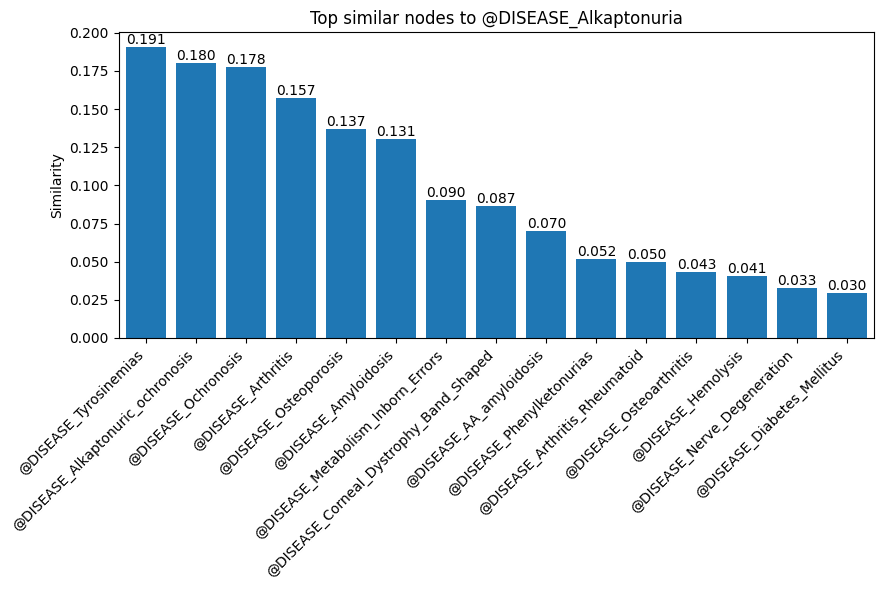

In [194]:
plot_top_similar_diseases_vertical(
    hiS,
    hidimaps,
    focal_name="@DISEASE_Alkaptonuria",
    k=20,
    min_sim=None,
    exclude_self=True,
    annotate=True,
    figsize=(9, 6),
    save_path=None,
)

## Chemical similarity 

### Define functions 

In [178]:
import networkx as nx
import scipy.sparse as sp

def build_chemical_similarity(
    G: nx.Graph,
    via=("gene","disease"),               # channels: C–G–C and/or C–D–C
    method=("cosine_tfidf", "pathsim"),   # combine similarity methods
    in_edges=True, out_edges=True,        # respect edge direction if G is directed
    use_weights=False, signed=False,      # use edge['weight'] / edge['sign'] if present
    weights_by_channel=None,              # e.g., {"gene":0.6,"disease":0.4}
    weights_by_method=None,               # e.g., {"cosine_tfidf":0.5,"pathsim":0.5}
    topk=20                               # keep top-k neighbors per chemical (None to skip)
):
    """
    Project a heterogeneous graph into a Chemical–Chemical similarity network.

    Returns:
      Hc (nx.Graph): chemical–chemical weighted similarity graph
      S (scipy.sparse.csr_matrix): similarity matrix aligned to `chemicals` order
      chemicals (list): chemical node order used in S
    """
    # Collect node sets by prefix/type
    chemicals = [n for n in G.nodes if _node_type(n) == "chemical"]
    genes     = [n for n in G.nodes if _node_type(n) == "gene"]
    diseases  = [n for n in G.nodes if _node_type(n) == "disease"]

    if not chemicals:
        raise ValueError("No @CHEMICAL nodes found.")

    # Prune unavailable channels
    via = tuple(via)
    if "gene" in via and not genes:
        via = tuple(x for x in via if x != "gene")
    if "disease" in via and not diseases:
        via = tuple(x for x in via if x != "disease")
    if not via:
        raise ValueError("No projection channels available (no genes/diseases present).")

    # Default weights
    if weights_by_channel is None:
        weights_by_channel = {ch: 1.0/len(via) for ch in via}
    mlist = tuple(method) if isinstance(method, (list, tuple)) else (method,)
    if weights_by_method is None:
        weights_by_method = {m: 1.0/len(mlist) for m in mlist}

    # Build per-channel similarity
    channel_sims = []
    for ch in via:
        if ch == "gene":
            # C x G incidence
            A = _build_incidence(G, chemicals, genes, "gene",
                                 in_edges=in_edges, out_edges=out_edges,
                                 use_weights=use_weights, signed=signed)
        elif ch == "disease":
            # C x D incidence
            A = _build_incidence(G, chemicals, diseases, "disease",
                                 in_edges=in_edges, out_edges=out_edges,
                                 use_weights=use_weights, signed=signed)
        else:
            raise ValueError(f"Unknown channel: {ch}")

        # Methods for this channel
        per_methods = []
        for m in mlist:
            if m == "cosine":
                per_methods.append(_cosine_sim(A, tfidf=False))
            elif m == "cosine_tfidf":
                per_methods.append(_cosine_sim(A, tfidf=True))
            elif m == "pathsim":
                per_methods.append(_pathsim(A))
            elif m == "hypergeom":
                per_methods.append(_hypergeom_overlap(A))
            else:
                raise ValueError(f"Unknown method: {m}")

        # Combine methods within channel
        m_weights = [weights_by_method[m] for m in mlist]
        ch_sim = _combine(per_methods, m_weights).multiply(weights_by_channel[ch])
        channel_sims.append(ch_sim)

    # Combine channels
    S = _combine(channel_sims, None)
    if S is None:
        raise RuntimeError("Failed to build any similarity matrix.")

    # Sparsify (top-k per row) and symmetrize
    S = _topk_per_row(S, topk)
    S = 0.5 * (S + S.T)

    # Build NetworkX graph
    Hc = nx.Graph()
    Hc.add_nodes_from(chemicals)
    rows, cols = S.nonzero()
    for i, j, w in zip(rows, cols, S.data):
        if i < j and w > 0:
            Hc.add_edge(chemicals[i], chemicals[j], weight=float(w))

    return Hc, S.tocsr(), chemicals


### Extend graph 

In [179]:
Hc, Sc, chemicals = build_chemical_similarity(
    filteredlv1graph,
    via=("gene","disease"),
    method=("cosine_tfidf","pathsim"),
    in_edges=True, out_edges=True,
    use_weights=True, signed=True,
    topk=25
)
# print(Hc.number_of_nodes(), Hc.number_of_edges())


(<Figure size 900x600 with 1 Axes>,
 <Axes: title={'center': 'Top similar nodes to @CHEMICAL_nitisinone'}, ylabel='Similarity'>,
 [('@CHEMICAL_Tyrosine', 0.2941423786679749),
  ('@CHEMICAL_Homogentisic_Acid', 0.1944351898642176),
  ('@CHEMICAL_Phenylalanine', 0.16498406188923087),
  ('@CHEMICAL_succinylacetone', 0.13496809954233568),
  ('@CHEMICAL_Fluorine', 0.10646083292412678),
  ('@CHEMICAL_Oxygen', 0.10306991581277773),
  ('@CHEMICAL_Carbon', 0.09569873819197439),
  ('@CHEMICAL_kaempferol', 0.09327657191144016),
  ('@CHEMICAL_pyrazolone', 0.09327657191144016),
  ('@CHEMICAL_Ascorbic_Acid', 0.08428477451483465),
  ('@CHEMICAL_4_hydroxyphenylpyruvic_acid', 0.08056151727132219),
  ('@CHEMICAL_4_((2_carboxyethyl)hydroxyphosphinyl)_3_oxobutyrate',
   0.07659828899278176),
  ('@CHEMICAL_Histidine', 0.07573509138030704),
  ('@CHEMICAL_Teriparatide', 0.07303430742883492),
  ('@CHEMICAL_hydroquinone', 0.07155857570557048),
  ('@CHEMICAL_Phenol', 0.07113815151062287),
  ('@CHEMICAL_Sulfates'

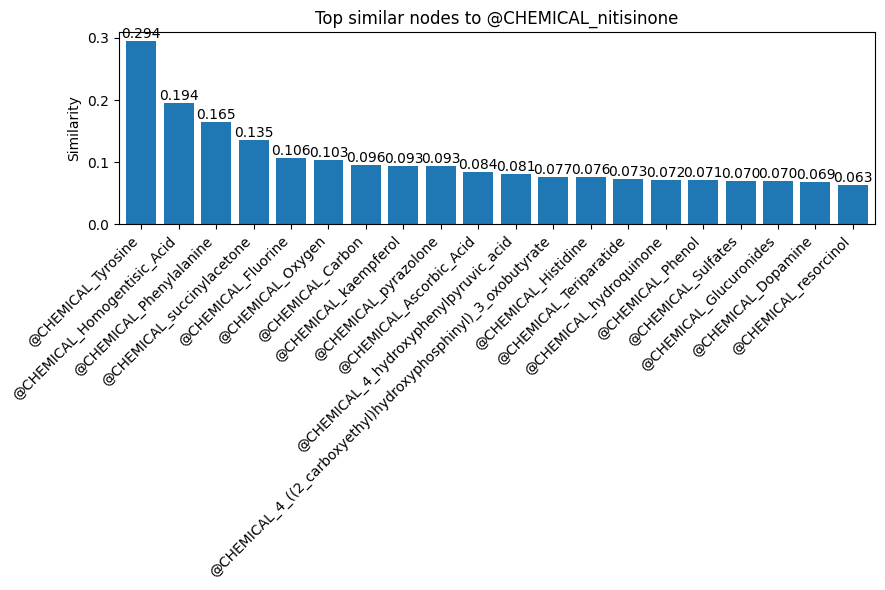

In [180]:
plot_top_similar_diseases_vertical(
    Sc,
    chemicals,
    focal_name="@CHEMICAL_nitisinone",
    k=20,
    min_sim=None,
    exclude_self=True,
    annotate=True,
    figsize=(9, 6),
    save_path=None,
)

### High confident network 

In [181]:
hiHc, hiSc, hichemicals = build_chemical_similarity(
    highconfgraph,
    via=("gene","disease"),
    method=("cosine_tfidf","pathsim"),
    in_edges=True, out_edges=True,
    use_weights=True, signed=True,
    topk=25
)
# print(Hc.number_of_nodes(), Hc.number_of_edges())


(<Figure size 900x600 with 1 Axes>,
 <Axes: title={'center': 'Top similar nodes to @CHEMICAL_nitisinone'}, ylabel='Similarity'>,
 [('@CHEMICAL_Tyrosine', 0.35996052750214813),
  ('@CHEMICAL_Homogentisic_Acid', 0.2525392607067519),
  ('@CHEMICAL_4_hydroxyphenylpyruvic_acid', 0.20004890325870595),
  ('@CHEMICAL_Phenylalanine', 0.1916350383910333),
  ('@CHEMICAL_Teriparatide', 0.12718915728778996),
  ('@CHEMICAL_Cortisone', 0.11728470593216384),
  ('@CHEMICAL_succinylacetone', 0.1063656222996961),
  ('@CHEMICAL_Ascorbic_Acid', 0.09790118754317897),
  ('@CHEMICAL_Phenol', 0.08454936833822074),
  ('@CHEMICAL_Denosumab', 0.08227430932504046),
  ('@CHEMICAL_Carbon_Dioxide', 0.08007119524311426),
  ('@CHEMICAL_Acetylcysteine', 0.07220705808528949),
  ('@CHEMICAL_Zoledronic_Acid', 0.06850988329354268),
  ('@CHEMICAL_Diphosphonates', 0.06817081522782467),
  ('@CHEMICAL_Lipids', 0.06802863643497328),
  ('@CHEMICAL_Taurine', 0.06802863643497328),
  ('@CHEMICAL_hydroquinone', 0.06255620272566662),


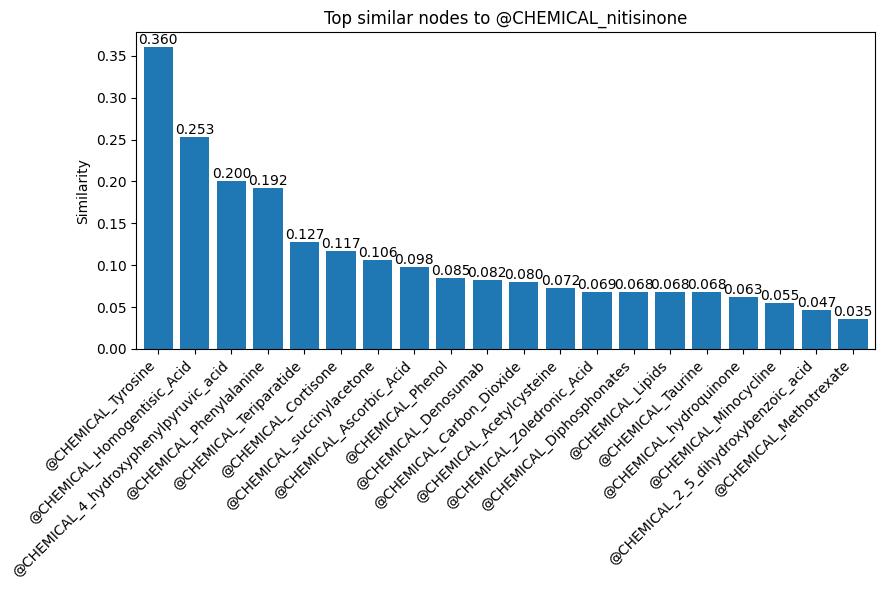

In [182]:
plot_top_similar_diseases_vertical(
    hiSc,
    hichemicals,
    focal_name="@CHEMICAL_nitisinone",
    k=20,
    min_sim=None,
    exclude_self=True,
    annotate=True,
    figsize=(9, 6),
    save_path=None,
)